In [ ]:
! pip install -q kaggle
import tensorflow as tf
import pandas as pd
from tensorflow.keras.applications import ResNet50, VGG16, InceptionV3
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.utils import to_categorical
import numpy as np
import os
from tensorflow.keras.preprocessing import image
import matplotlib.pyplot as plt


In [ ]:
from zipfile import ZipFile
dataset='/content/Flowers_Classification.v2-raw.folder.zip'

with ZipFile(dataset,'r') as zip:
  zip.extractall()
  print('The dataset is extracted')

The dataset is extracted


In [ ]:
import tensorflow as tf
import pandas as pd
from tensorflow.keras.applications import ResNet50, VGG16, InceptionV3
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.utils import to_categorical
import numpy as np
import os

In [ ]:
train_data_path = '/content/train'
test_data_path = '/content/test'

In [ ]:
classes_size = 5
print("Total number of classes: ", classes_size)

Total number of classes:  5


In [ ]:
# Load the pre-trained ResNet50 model
resnet_model = ResNet50(weights='imagenet', include_top=False)
# Load the pre-trained VGG16 model
vgg_model = VGG16(weights='imagenet', include_top=False)
# Load the pre-trained InceptionV3 model
inception_model = InceptionV3(weights='imagenet', include_top=False)

In [ ]:
resnet_x = resnet_model.output
resnet_x = GlobalAveragePooling2D()(resnet_x)
resnet_x = Dense(1024, activation='relu')(resnet_x)
resnet_predictions = Dense(classes_size, activation='softmax')(resnet_x)

vgg_x = vgg_model.output
vgg_x = GlobalAveragePooling2D()(vgg_x)
vgg_x = Dense(1024, activation='relu')(vgg_x)
vgg_predictions = Dense(classes_size, activation='softmax')(vgg_x)

inception_x = inception_model.output
inception_x = GlobalAveragePooling2D()(inception_x)
inception_x = Dense(1024, activation='relu')(inception_x)
inception_predictions = Dense(classes_size, activation='softmax')(inception_x)

In [ ]:
resnet_model_final = Model(inputs=resnet_model.input, outputs=resnet_predictions)
vgg_model_final = Model(inputs=vgg_model.input, outputs=vgg_predictions)
inception_model_final = Model(inputs=inception_model.input, outputs=inception_predictions)

# Freeze the layers of the base models
for layer in resnet_model.layers:
    layer.trainable = False
for layer in vgg_model.layers:
    layer.trainable = False
for layer in inception_model.layers:
    layer.trainable = False

In [ ]:
resnet_model_final.compile(optimizer=Adam(), loss='categorical_crossentropy', metrics=['accuracy'])
vgg_model_final.compile(optimizer=Adam(), loss='categorical_crossentropy', metrics=['accuracy'])
inception_model_final.compile(optimizer=Adam(), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
train_datagen = ImageDataGenerator(rescale=1./255)
test_datagen = ImageDataGenerator(rescale=1./255)

batch_size = 32

train_generator = train_datagen.flow_from_directory(
    train_data_path,
    target_size=(224, 224),
    batch_size=batch_size,
    class_mode='categorical'
)

test_generator = test_datagen.flow_from_directory(
    test_data_path,
    target_size=(224, 224),
    batch_size=batch_size,
    class_mode='categorical'
)


Found 3795 images belonging to 5 classes.
Found 215 images belonging to 5 classes.


In [ ]:
resnet_model_final.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=35,
    validation_data=test_generator,
    validation_steps=len(test_generator)
)



Epoch 1/35
119/119 [==============================] - 23s 165ms/step - loss: 0.9189 - accuracy: 0.6669 - val_loss: 0.6541 - val_accuracy: 0.7488
Epoch 2/35
119/119 [==============================] - 14s 119ms/step - loss: 0.5194 - accuracy: 0.8132 - val_loss: 0.5618 - val_accuracy: 0.8000
Epoch 3/35
119/119 [==============================] - 13s 112ms/step - loss: 0.3984 - accuracy: 0.8609 - val_loss: 0.6819 - val_accuracy: 0.7023
Epoch 4/35
119/119 [==============================] - 13s 112ms/step - loss: 0.3361 - accuracy: 0.8833 - val_loss: 0.6455 - val_accuracy: 0.7349
Epoch 5/35
119/119 [==============================] - 13s 112ms/step - loss: 0.2912 - accuracy: 0.8922 - val_loss: 0.5317 - val_accuracy: 0.7767
Epoch 6/35
119/119 [==============================] - 14s 113ms/step - loss: 0.2663 - accuracy: 0.8991 - val_loss: 0.4851 - val_accuracy: 0.8000
Epoch 7/35
119/119 [==============================] - 14s 114ms/step - loss: 0.2628 - accuracy: 0.8993 - val_loss: 0.4757 - val_ac

In [ ]:
vgg_model_final.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=10,
    validation_data=test_generator,
    validation_steps=len(test_generator)
)

Epoch 1/10
119/119 [==============================] - 27s 219ms/step - loss: 0.4340 - accuracy: 0.8659 - val_loss: 0.3348 - val_accuracy: 0.8558
Epoch 2/10
119/119 [==============================] - 16s 137ms/step - loss: 0.1333 - accuracy: 0.9536 - val_loss: 0.3667 - val_accuracy: 0.8512
Epoch 3/10
119/119 [==============================] - 16s 134ms/step - loss: 0.0968 - accuracy: 0.9642 - val_loss: 0.2963 - val_accuracy: 0.8605
Epoch 4/10
119/119 [==============================] - 16s 132ms/step - loss: 0.0841 - accuracy: 0.9673 - val_loss: 0.3800 - val_accuracy: 0.8465
Epoch 5/10
119/119 [==============================] - 16s 135ms/step - loss: 0.0672 - accuracy: 0.9723 - val_loss: 0.2445 - val_accuracy: 0.8884
Epoch 6/10
119/119 [==============================] - 16s 134ms/step - loss: 0.0613 - accuracy: 0.9758 - val_loss: 0.2530 - val_accuracy: 0.8930
Epoch 7/10
119/119 [==============================] - 16s 134ms/step - loss: 0.0619 - accuracy: 0.9742 - val_loss: 0.2787 - val_ac

In [ ]:
inception_model_final.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=4,
    validation_data=test_generator,
    validation_steps=len(test_generator)
)

Epoch 1/4
119/119 [==============================] - 20s 132ms/step - loss: 0.2993 - accuracy: 0.9157 - val_loss: 0.1833 - val_accuracy: 0.9209
Epoch 2/4
119/119 [==============================] - 10s 82ms/step - loss: 0.0508 - accuracy: 0.9818 - val_loss: 0.2336 - val_accuracy: 0.8977
Epoch 3/4
119/119 [==============================] - 10s 84ms/step - loss: 0.0343 - accuracy: 0.9889 - val_loss: 0.2000 - val_accuracy: 0.9395
Epoch 4/4
119/119 [==============================] - 10s 81ms/step - loss: 0.0289 - accuracy: 0.9892 - val_loss: 0.3956 - val_accuracy: 0.9023


In [ ]:
def preprocess_image(image_path):
    img = image.load_img(image_path, target_size=(224, 224))
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    return img_array / 255.0

def predict_image(model, image_path):
    preprocessed_img = preprocess_image(image_path)
    prediction = model.predict(preprocessed_img)
    return prediction

def get_image_paths(root_dir):
    image_paths = []
    for subdir, _, files in os.walk(root_dir):
        for file in files:
            if file.endswith('.jpg') or file.endswith('.jpeg') or file.endswith('.png'):
                image_paths.append(os.path.join(subdir, file))
    return image_paths

In [ ]:
test_folder_path = '/content/test'

test_image_paths = get_image_paths(test_folder_path)

Image: /content/test/daisy/754248840_95092de274_jpg.rf.5c15a2fc56cb948559bf57dbf87c69d6.jpg


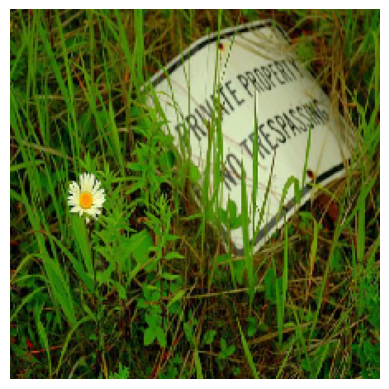

1/1 [==============================] - 1s 875ms/step
ResNet50 Prediction: [[4.2552006e-01 5.7443374e-01 1.0480943e-06 4.4703167e-05 4.0333248e-07]]
1/1 [==============================] - 0s 144ms/step
VGG16 Prediction: [[2.9934344e-01 7.0064807e-01 8.3829354e-06 5.2872782e-08 4.4549928e-12]]
1/1 [==============================] - 1s 1s/step
InceptionV3 Prediction: [[9.9703443e-01 2.9488248e-03 7.5012704e-06 9.3100725e-06 6.5102372e-09]]

Image: /content/test/daisy/9221345475_67735dbf4f_n_jpg.rf.0b725c9a5e7b3fa7e186056184b4ced4.jpg


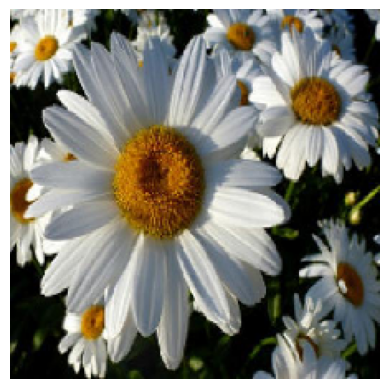

1/1 [==============================] - 0s 32ms/step
ResNet50 Prediction: [[9.6112669e-01 3.8873266e-02 2.8570889e-12 6.2261689e-11 2.4265268e-10]]
1/1 [==============================] - 0s 18ms/step
VGG16 Prediction: [[9.99981880e-01 1.79884046e-05 1.04055104e-07 6.98389332e-11
  2.07765405e-13]]
1/1 [==============================] - 0s 38ms/step
InceptionV3 Prediction: [[1.0000000e+00 1.7087139e-09 1.3205410e-12 9.2908035e-11 2.8026137e-14]]

Image: /content/test/daisy/14569895116_32f0dcb0f9_jpg.rf.73199cb0ad1cb9aa37d36b16a3c9b46c.jpg


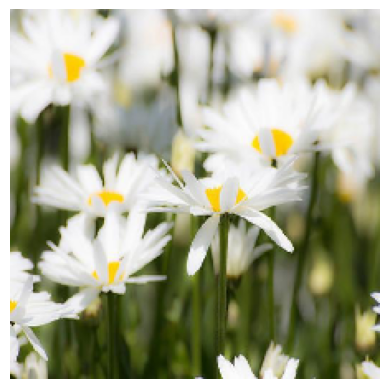

1/1 [==============================] - 0s 21ms/step
ResNet50 Prediction: [[9.4200099e-01 5.7998560e-02 5.1987225e-12 1.4609538e-12 4.3160361e-07]]
1/1 [==============================] - 0s 18ms/step
VGG16 Prediction: [[9.8248392e-01 1.7481953e-02 3.3258355e-05 8.7862151e-07 1.0388473e-10]]
1/1 [==============================] - 0s 29ms/step
InceptionV3 Prediction: [[9.9995899e-01 3.4027660e-05 1.6035980e-06 5.4501975e-06 8.4160323e-09]]

Image: /content/test/daisy/5904946193_bd1eb1f39d_n_jpg.rf.30f7c73f16b310f3ea36ab88cca6965d.jpg


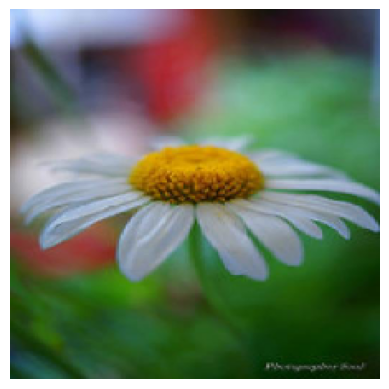

1/1 [==============================] - 0s 22ms/step
ResNet50 Prediction: [[4.2182797e-01 5.7814026e-01 4.0399928e-07 1.0427878e-05 2.0922644e-05]]
1/1 [==============================] - 0s 18ms/step
VGG16 Prediction: [[9.9757832e-01 2.4207421e-03 3.1493036e-07 5.9554986e-07 1.1989182e-10]]
1/1 [==============================] - 0s 25ms/step
InceptionV3 Prediction: [[9.99999404e-01 5.26226302e-07 1.67216740e-09 1.01125494e-07
  8.61800770e-11]]

Image: /content/test/daisy/2632216904_274aa17433_jpg.rf.45300162290259cfe9a680945d85c3f4.jpg


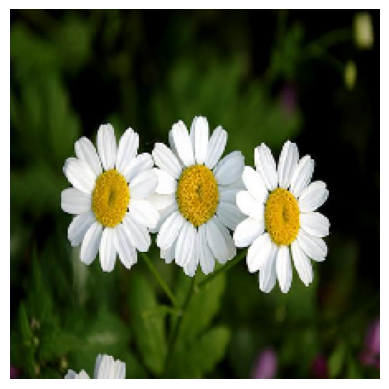

1/1 [==============================] - 0s 23ms/step
ResNet50 Prediction: [[9.9946362e-01 5.3640082e-04 1.5527419e-16 4.9756865e-09 6.8247703e-18]]
1/1 [==============================] - 0s 18ms/step
VGG16 Prediction: [[9.9987280e-01 1.2609090e-04 9.6180656e-07 9.9782888e-08 5.7627566e-11]]
1/1 [==============================] - 0s 27ms/step
InceptionV3 Prediction: [[9.9999952e-01 4.9251719e-07 1.5195986e-09 4.9488381e-08 6.1693130e-11]]

Image: /content/test/daisy/1342002397_9503c97b49_jpg.rf.8fe6bdd23186b70f089bb0c5b89d314e.jpg


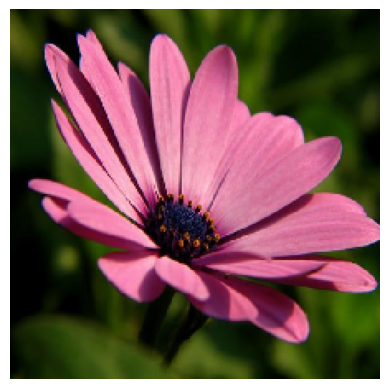

1/1 [==============================] - 0s 24ms/step
ResNet50 Prediction: [[8.8928598e-01 1.1071374e-01 2.2231285e-08 4.9773165e-11 3.0134242e-07]]
1/1 [==============================] - 0s 23ms/step
VGG16 Prediction: [[9.9997485e-01 3.0078979e-06 2.2147580e-05 1.3373203e-08 1.3459485e-09]]
1/1 [==============================] - 0s 28ms/step
InceptionV3 Prediction: [[9.9999368e-01 6.1351211e-06 1.5104677e-08 2.6918900e-07 5.8153443e-10]]

Image: /content/test/daisy/14707111433_cce08ee007_jpg.rf.5115333810dba8244f35512c99703520.jpg


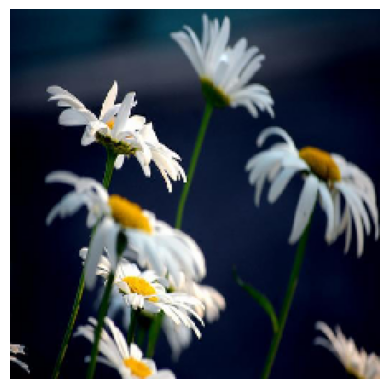

1/1 [==============================] - 0s 23ms/step
ResNet50 Prediction: [[9.7557360e-01 2.4426270e-02 3.2549608e-12 9.0163390e-08 6.8698110e-11]]
1/1 [==============================] - 0s 24ms/step
VGG16 Prediction: [[9.9609333e-01 3.9011706e-03 2.3972063e-06 6.1361732e-07 2.4450703e-06]]
1/1 [==============================] - 0s 29ms/step
InceptionV3 Prediction: [[9.9999952e-01 4.7610237e-07 1.0990109e-09 5.3002523e-08 8.3026828e-11]]

Image: /content/test/daisy/10466558316_a7198b87e2_jpg.rf.7acf642b94dc98daa49482a12994ac4c.jpg


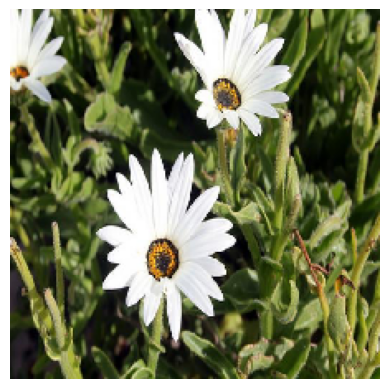

1/1 [==============================] - 0s 30ms/step
ResNet50 Prediction: [[9.9978572e-01 2.1433974e-04 3.7133051e-17 1.0380349e-16 2.3487324e-18]]
1/1 [==============================] - 0s 19ms/step
VGG16 Prediction: [[9.9556267e-01 4.4236993e-03 1.3616508e-05 5.2285638e-09 1.5964720e-13]]
1/1 [==============================] - 0s 26ms/step
InceptionV3 Prediction: [[1.0000000e+00 3.0163097e-08 1.0384211e-10 1.9456150e-09 5.8152729e-13]]

Image: /content/test/daisy/15813862117_dedcd1c56f_m_jpg.rf.81321871cfb8bfb90da77972a8bd257e.jpg


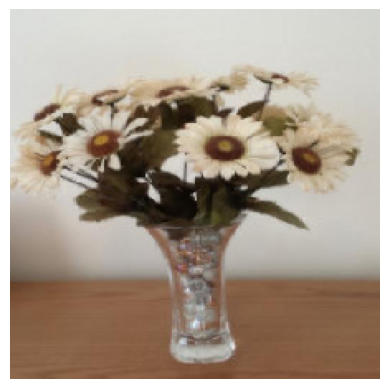

1/1 [==============================] - 0s 32ms/step
ResNet50 Prediction: [[9.2924011e-01 7.0759967e-02 5.8481800e-13 2.6380638e-09 7.6194351e-10]]
1/1 [==============================] - 0s 20ms/step
VGG16 Prediction: [[9.9236852e-01 2.7155636e-03 1.4604714e-06 4.9089580e-03 5.5346641e-06]]
1/1 [==============================] - 0s 27ms/step
InceptionV3 Prediction: [[9.6333748e-01 3.6422361e-02 1.1101912e-04 1.2294864e-04 6.2222680e-06]]

Image: /content/test/daisy/16737503507_431768a927_jpg.rf.b2631742878b5c60bbb3eb7824623b55.jpg


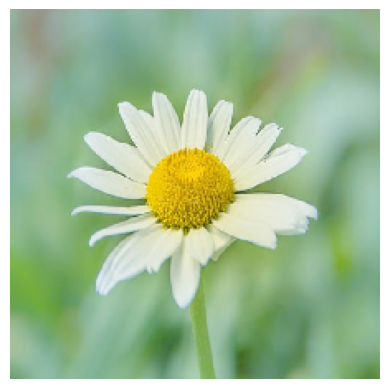

1/1 [==============================] - 0s 22ms/step
ResNet50 Prediction: [[5.6768888e-01 4.3127760e-01 6.5776919e-07 1.0120346e-03 2.0851088e-05]]
1/1 [==============================] - 0s 23ms/step
VGG16 Prediction: [[9.9979657e-01 2.0048219e-04 2.7153760e-06 2.8011073e-07 1.1681175e-09]]
1/1 [==============================] - 0s 25ms/step
InceptionV3 Prediction: [[9.9999976e-01 2.9039629e-07 3.8894257e-10 1.7803744e-08 1.0181372e-11]]

Image: /content/test/daisy/16482676953_5296227d40_n_jpg.rf.7ec79fc5ef598518544d96863254c3be.jpg


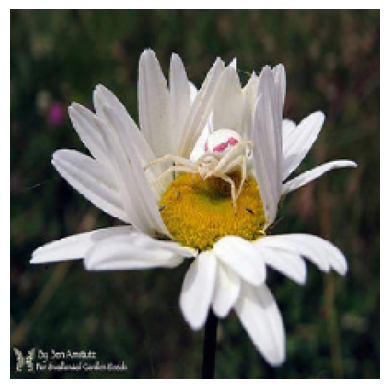

1/1 [==============================] - 0s 24ms/step
ResNet50 Prediction: [[9.9475503e-01 5.2449284e-03 1.3112536e-13 1.0844643e-09 4.1294555e-12]]
1/1 [==============================] - 0s 21ms/step
VGG16 Prediction: [[9.9990714e-01 3.1975989e-05 6.0826580e-05 9.1375931e-08 4.3908153e-09]]
1/1 [==============================] - 0s 38ms/step
InceptionV3 Prediction: [[9.9999976e-01 1.6944772e-07 1.1040979e-09 1.4934668e-07 5.0418687e-11]]

Image: /content/test/daisy/22244161124_53e457bb66_n_jpg.rf.0647dd5bf7e8b1493bf4ab1aabe2df3e.jpg


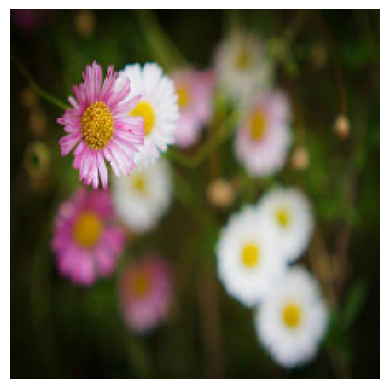

1/1 [==============================] - 0s 28ms/step
ResNet50 Prediction: [[7.1742433e-01 2.8257257e-01 7.9913825e-08 2.2052095e-06 8.9653224e-07]]
1/1 [==============================] - 0s 19ms/step
VGG16 Prediction: [[8.5321957e-01 1.4661485e-01 6.0728746e-07 1.6438395e-04 6.0482989e-07]]
1/1 [==============================] - 0s 28ms/step
InceptionV3 Prediction: [[9.9999988e-01 6.7786502e-08 7.8873444e-12 2.0731621e-10 1.1368492e-13]]

Image: /content/test/daisy/33855966243_01b2486428_n_jpg.rf.5f9f2886770c4b36b6231c2aa92c12cb.jpg


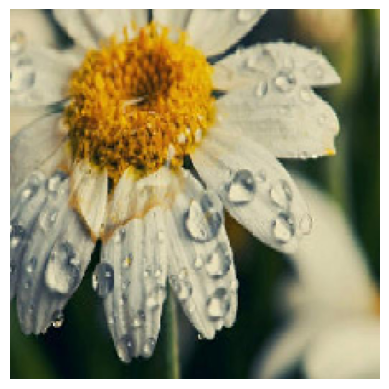

1/1 [==============================] - 0s 32ms/step
ResNet50 Prediction: [[5.4414105e-01 4.5585862e-01 5.9602218e-10 2.5762196e-07 7.8706833e-08]]
1/1 [==============================] - 0s 25ms/step
VGG16 Prediction: [[4.9083680e-01 5.0915831e-01 1.5020311e-06 3.4406403e-06 3.1134648e-10]]
1/1 [==============================] - 0s 28ms/step
InceptionV3 Prediction: [[9.9999917e-01 8.7860536e-07 1.1607731e-09 3.9239719e-08 4.2052826e-11]]

Image: /content/test/daisy/2579018590_74359dcf1a_m_jpg.rf.09c66018bd90f02891f966ce3d0c4c47.jpg


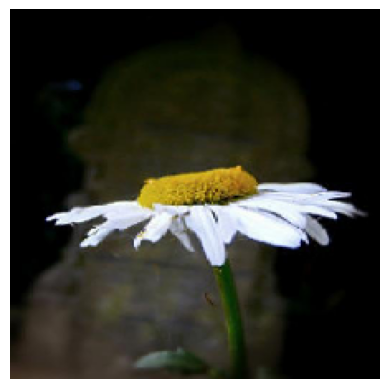

1/1 [==============================] - 0s 24ms/step
ResNet50 Prediction: [[9.7958046e-01 2.0419540e-02 9.5490166e-15 1.1508060e-10 1.0531082e-10]]
1/1 [==============================] - 0s 25ms/step
VGG16 Prediction: [[9.9891579e-01 1.0152131e-03 1.8470030e-07 6.8805159e-05 1.0025560e-07]]
1/1 [==============================] - 0s 27ms/step
InceptionV3 Prediction: [[1.0000000e+00 9.8351087e-09 2.8323786e-11 9.9507136e-10 1.0720104e-12]]

Image: /content/test/daisy/1374193928_a52320eafa_jpg.rf.e398f632151f3ccc5729bc89527d7614.jpg


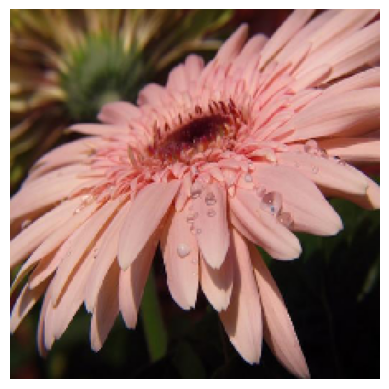

1/1 [==============================] - 0s 54ms/step
ResNet50 Prediction: [[5.2117151e-01 4.7882846e-01 1.2649821e-11 7.9365115e-08 3.7467323e-09]]
1/1 [==============================] - 0s 38ms/step
VGG16 Prediction: [[9.7168839e-01 2.8211385e-02 1.0021592e-04 2.7622000e-09 9.9315543e-13]]
1/1 [==============================] - 0s 46ms/step
InceptionV3 Prediction: [[9.9990034e-01 9.9532968e-05 2.2746846e-08 1.4961253e-07 5.1062954e-10]]

Image: /content/test/daisy/14866200659_6462c723cb_m_jpg.rf.ca61b503fd16ed5f84c8f980bf260850.jpg


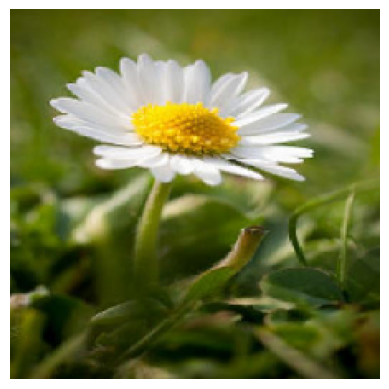

1/1 [==============================] - 0s 36ms/step
ResNet50 Prediction: [[8.5961097e-01 1.4038907e-01 3.8072176e-12 2.9502829e-09 8.3487492e-09]]
1/1 [==============================] - 0s 52ms/step
VGG16 Prediction: [[9.6009433e-01 3.9902955e-02 2.6505081e-06 8.3565745e-08 4.4603171e-12]]
1/1 [==============================] - 0s 59ms/step
InceptionV3 Prediction: [[9.9999988e-01 1.4261667e-07 3.1179839e-10 1.4884697e-08 9.9882385e-12]]

Image: /content/test/daisy/2578695910_5ab8ee17c1_n_jpg.rf.f6a916f0f067f27b7b8501051db99c48.jpg


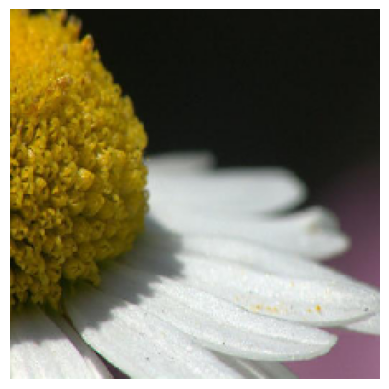

1/1 [==============================] - 0s 48ms/step
ResNet50 Prediction: [[4.6720794e-01 5.3278440e-01 3.3506637e-07 2.0691771e-06 5.2731261e-06]]
1/1 [==============================] - 0s 49ms/step
VGG16 Prediction: [[9.0744698e-01 9.0512887e-02 2.5774823e-05 2.0142894e-03 8.9129655e-09]]
1/1 [==============================] - 0s 71ms/step
InceptionV3 Prediction: [[9.9999678e-01 3.1740055e-06 9.5589148e-10 1.5988801e-08 1.2382960e-11]]

Image: /content/test/daisy/2621723097_736febb4a4_n_jpg.rf.3a6955a230ab66a0f09bf833bae5761b.jpg


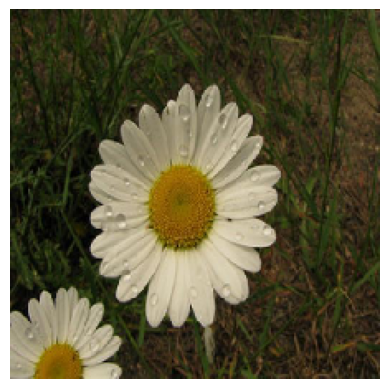

1/1 [==============================] - 0s 45ms/step
ResNet50 Prediction: [[6.4115489e-01 3.5884249e-01 9.4245300e-10 2.4831836e-06 5.9716875e-08]]
1/1 [==============================] - 0s 45ms/step
VGG16 Prediction: [[9.9945599e-01 5.4121763e-04 2.4455269e-06 2.9700701e-07 1.3782936e-11]]
1/1 [==============================] - 0s 40ms/step
InceptionV3 Prediction: [[9.9999940e-01 5.5031830e-07 7.3242445e-10 4.8894936e-08 1.2167922e-11]]

Image: /content/test/daisy/33814092924_b23d019011_n_jpg.rf.dbf071a3be1a8b3dcc44b5331d102482.jpg


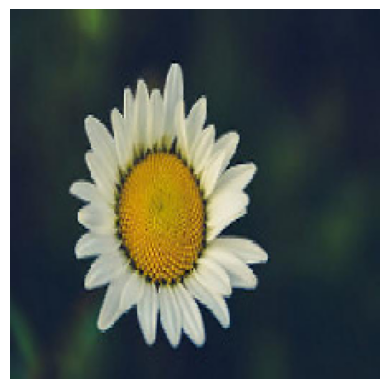

1/1 [==============================] - 0s 38ms/step
ResNet50 Prediction: [[8.5349613e-01 1.4650185e-01 1.3755972e-08 1.2604125e-06 6.7534671e-07]]
1/1 [==============================] - 0s 41ms/step
VGG16 Prediction: [[9.9915230e-01 8.4207574e-04 4.9062596e-06 6.7316694e-07 2.6036615e-09]]
1/1 [==============================] - 0s 52ms/step
InceptionV3 Prediction: [[9.9999869e-01 1.2291749e-06 2.4039455e-09 8.5864627e-08 3.7521940e-11]]

Image: /content/test/daisy/33810542134_a493f19a71_n_jpg.rf.1f84faf9a3e2b1dfd1a0db12829b6eb7.jpg


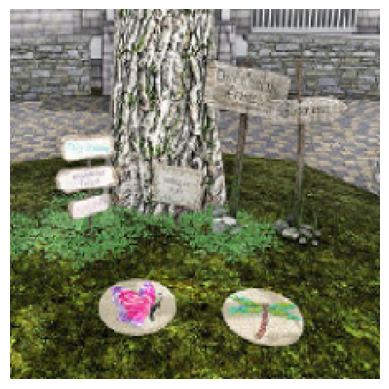

1/1 [==============================] - 0s 56ms/step
ResNet50 Prediction: [[2.4381341e-01 7.5618660e-01 2.5236628e-09 1.5634343e-09 1.9875559e-09]]
1/1 [==============================] - 0s 25ms/step
VGG16 Prediction: [[7.0316178e-01 2.9682681e-01 7.1867021e-06 4.2715765e-06 1.0298874e-09]]
1/1 [==============================] - 0s 37ms/step
InceptionV3 Prediction: [[7.9307687e-01 2.0378740e-01 6.3040480e-04 2.4894953e-03 1.5830194e-05]]

Image: /content/test/daisy/18622672908_eab6dc9140_n_jpg.rf.89def480591c1c229e7e416383dadbf3.jpg


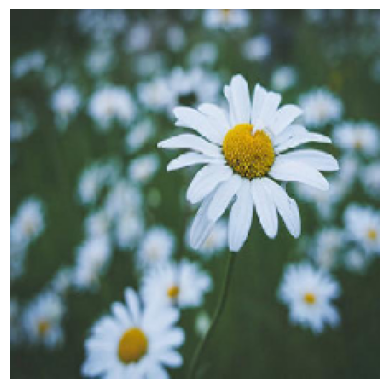

1/1 [==============================] - 0s 33ms/step
ResNet50 Prediction: [[8.3378100e-01 1.6621904e-01 5.7619105e-12 1.3168319e-09 1.4379850e-10]]
1/1 [==============================] - 0s 24ms/step
VGG16 Prediction: [[9.9990475e-01 9.3572213e-05 7.0770930e-08 1.6213191e-06 2.9340645e-09]]
1/1 [==============================] - 0s 36ms/step
InceptionV3 Prediction: [[9.9999988e-01 1.7297215e-07 1.9885374e-10 2.4966623e-08 1.3811020e-11]]

Image: /content/test/daisy/10466290366_cc72e33532_jpg.rf.6ddc91cd5d4a6a683e567ccb37e5a089.jpg


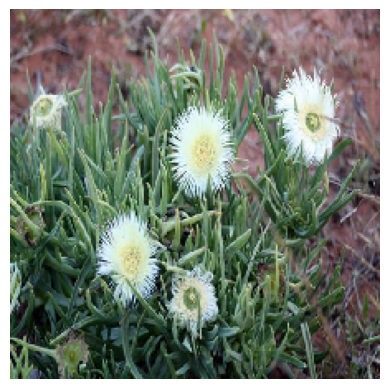

1/1 [==============================] - 0s 35ms/step
ResNet50 Prediction: [[1.6321188e-01 8.3678806e-01 7.6871717e-11 1.8986727e-08 1.6543114e-09]]
1/1 [==============================] - 0s 24ms/step
VGG16 Prediction: [[2.3054264e-01 7.6944643e-01 8.3253690e-06 2.5927316e-06 3.6489345e-10]]
1/1 [==============================] - 0s 36ms/step
InceptionV3 Prediction: [[9.9983108e-01 1.6891508e-04 1.1882913e-08 1.3262343e-08 3.5861906e-12]]

Image: /content/test/daisy/6299498346_b9774b6500_jpg.rf.f88a6eddc7fd755ce88201e09042e243.jpg


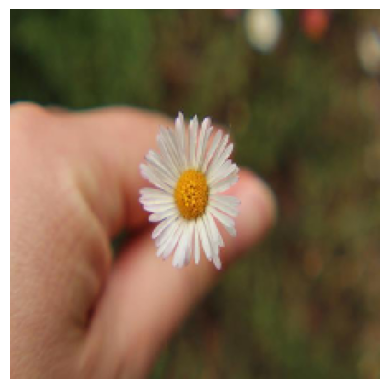

1/1 [==============================] - 0s 34ms/step
ResNet50 Prediction: [[5.3572470e-01 4.6339095e-01 6.2241911e-06 6.5901797e-05 8.1225147e-04]]
1/1 [==============================] - 0s 25ms/step
VGG16 Prediction: [[9.9917632e-01 7.5317238e-04 1.4204882e-06 6.9116781e-05 1.3307968e-08]]
1/1 [==============================] - 0s 41ms/step
InceptionV3 Prediction: [[1.0000000e+00 5.3618326e-08 1.0994863e-11 7.5456702e-10 5.7782745e-14]]

Image: /content/test/daisy/15760153042_a2a90e9da5_m_jpg.rf.697d305f979af39340e1b9c9d9ee8b0f.jpg


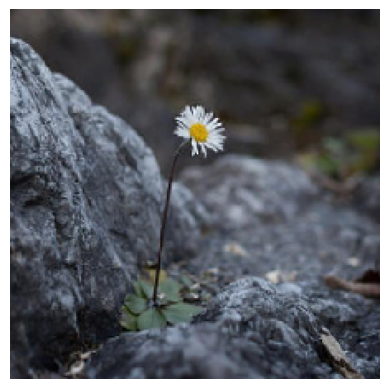

1/1 [==============================] - 0s 36ms/step
ResNet50 Prediction: [[4.3626150e-01 5.6370783e-01 6.0486070e-07 7.7762334e-06 2.2271772e-05]]
1/1 [==============================] - 0s 28ms/step
VGG16 Prediction: [[2.7786547e-01 7.2204459e-01 3.2875616e-06 8.6676082e-05 3.5181497e-10]]
1/1 [==============================] - 0s 35ms/step
InceptionV3 Prediction: [[9.9978977e-01 2.1026368e-04 5.6545835e-09 6.3693921e-09 7.0793970e-12]]

Image: /content/test/daisy/6776075110_1ea7a09dd4_n_jpg.rf.6e2cedfbd3d2732699dfd7f53a967866.jpg


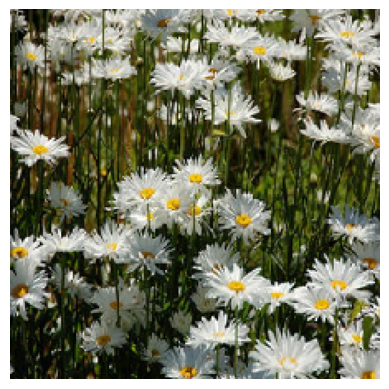

1/1 [==============================] - 0s 35ms/step
ResNet50 Prediction: [[9.0000373e-01 9.9996313e-02 3.8715836e-20 9.7332804e-18 9.0718362e-16]]
1/1 [==============================] - 0s 25ms/step
VGG16 Prediction: [[7.1506637e-01 2.8486648e-01 2.0447133e-07 6.6927118e-05 5.5790412e-09]]
1/1 [==============================] - 0s 38ms/step
InceptionV3 Prediction: [[9.9999988e-01 1.2155775e-07 3.2050026e-11 3.6243067e-10 3.4318449e-13]]

Image: /content/test/daisy/14907815010_bff495449f_jpg.rf.8ed410efb31aa282c8fb6002e36348e2.jpg


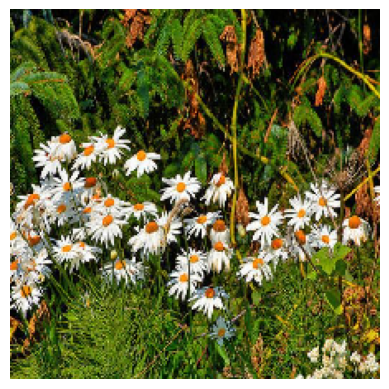

1/1 [==============================] - 0s 32ms/step
ResNet50 Prediction: [[9.9916792e-01 8.3212036e-04 3.5516525e-23 6.2378052e-19 1.7946478e-20]]
1/1 [==============================] - 0s 24ms/step
VGG16 Prediction: [[7.4690270e-01 2.5308308e-01 6.1989977e-06 8.0875616e-06 6.1540056e-10]]
1/1 [==============================] - 0s 37ms/step
InceptionV3 Prediction: [[9.9999809e-01 1.9324018e-06 2.6973765e-10 1.1673951e-09 4.3912664e-12]]

Image: /content/test/daisy/3699235066_fc09a02dfe_m_jpg.rf.083993c3ebd5cfdb89aef2abc23535fa.jpg


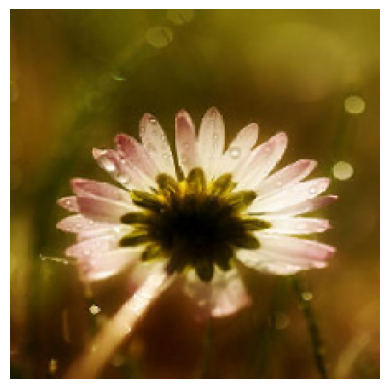

1/1 [==============================] - 0s 33ms/step
ResNet50 Prediction: [[8.0008721e-01 1.9990395e-01 1.3003394e-09 8.8599872e-06 2.7883519e-08]]
1/1 [==============================] - 0s 28ms/step
VGG16 Prediction: [[9.7149163e-01 2.8505662e-02 2.0146863e-06 6.5942794e-07 1.9871814e-10]]
1/1 [==============================] - 0s 37ms/step
InceptionV3 Prediction: [[9.9999416e-01 5.8075661e-06 2.8493683e-09 5.3615150e-08 9.4089833e-11]]

Image: /content/test/daisy/8709535323_a6bea3e43f_jpg.rf.0811cb3a0ef1b6eed5a91fb6f31c9a01.jpg


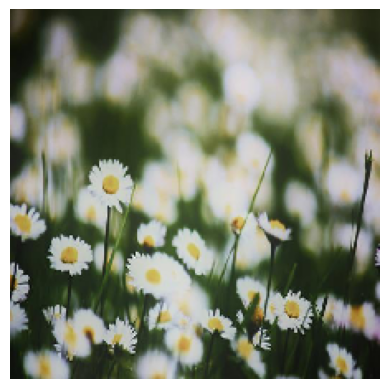

1/1 [==============================] - 0s 32ms/step
ResNet50 Prediction: [[6.5752274e-01 3.4247723e-01 2.2068607e-13 1.5156089e-10 8.9720800e-12]]
1/1 [==============================] - 0s 26ms/step
VGG16 Prediction: [[8.1679618e-01 1.8312718e-01 6.1497008e-06 7.0006601e-05 4.8727327e-07]]
1/1 [==============================] - 0s 38ms/step
InceptionV3 Prediction: [[9.9997258e-01 2.5866331e-05 4.7159304e-08 1.4623907e-06 3.1326837e-09]]

Image: /content/test/daisy/2877860110_a842f8b14a_m_jpg.rf.3534cdaf6c444986f34a010349914cf5.jpg


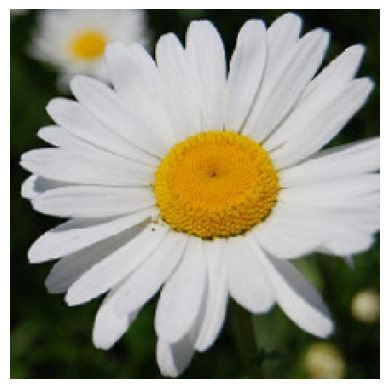

1/1 [==============================] - 0s 32ms/step
ResNet50 Prediction: [[9.8165292e-01 1.8346932e-02 2.5107775e-11 3.4705828e-08 1.7127570e-07]]
1/1 [==============================] - 0s 27ms/step
VGG16 Prediction: [[9.9999487e-01 4.8407223e-06 2.3840734e-07 2.1906579e-10 3.0729674e-14]]
1/1 [==============================] - 0s 39ms/step
InceptionV3 Prediction: [[9.9999976e-01 2.2849073e-07 2.3156128e-10 2.0687832e-08 3.9701072e-12]]

Image: /content/test/daisy/33874126263_3f6f965784_n_jpg.rf.140df6339c7cfdd085f75b7ab7b802f4.jpg


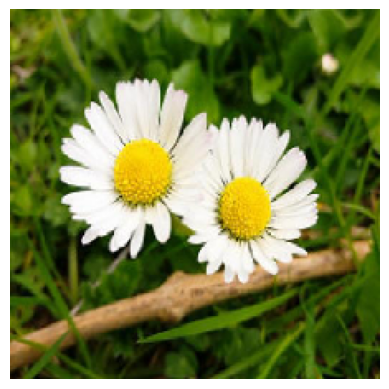

1/1 [==============================] - 0s 33ms/step
ResNet50 Prediction: [[9.4808495e-01 5.1915079e-02 2.2242350e-11 4.1002259e-08 2.3605623e-10]]
1/1 [==============================] - 0s 27ms/step
VGG16 Prediction: [[9.9795890e-01 2.0375024e-03 3.6273282e-06 4.9360384e-11 1.9734671e-15]]
1/1 [==============================] - 0s 38ms/step
InceptionV3 Prediction: [[9.9999893e-01 1.0673302e-06 4.8888615e-10 2.4190612e-08 7.1447488e-12]]

Image: /content/test/daisy/2520369272_1dcdb5a892_m_jpg.rf.497ae682965d0b1bd4089c348664664b.jpg


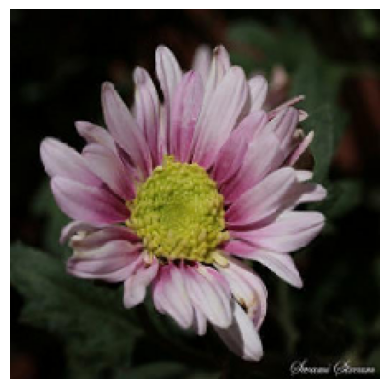

1/1 [==============================] - 0s 34ms/step
ResNet50 Prediction: [[7.4621350e-01 2.5378612e-01 9.8676169e-09 3.7884007e-07 1.3225124e-08]]
1/1 [==============================] - 0s 27ms/step
VGG16 Prediction: [[9.9961334e-01 3.8296310e-04 3.4575617e-06 2.8388567e-07 5.0845089e-11]]
1/1 [==============================] - 0s 44ms/step
InceptionV3 Prediction: [[9.9999678e-01 3.1057980e-06 3.7395376e-09 5.8178863e-08 1.0746613e-10]]

Image: /content/test/daisy/2482982436_a2145359e0_n_jpg.rf.fd93adb01dd4053a500ec796e81d6187.jpg


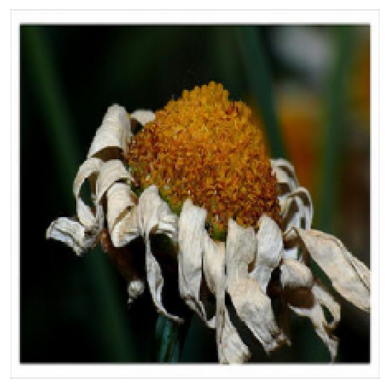

1/1 [==============================] - 0s 39ms/step
ResNet50 Prediction: [[8.2017040e-01 1.7982955e-01 5.4023057e-11 3.2752412e-10 7.5835874e-12]]
1/1 [==============================] - 0s 25ms/step
VGG16 Prediction: [[6.9542629e-01 1.4504318e-01 3.3938686e-05 1.5949659e-01 2.2582963e-08]]
1/1 [==============================] - 0s 37ms/step
InceptionV3 Prediction: [[9.9999380e-01 6.2495492e-06 9.1083402e-10 3.8466535e-08 1.5820550e-11]]

Image: /content/test/daisy/4565255237_9ba29c4d4e_n_jpg.rf.c6ae54e9181acdb486e9360ada21921a.jpg


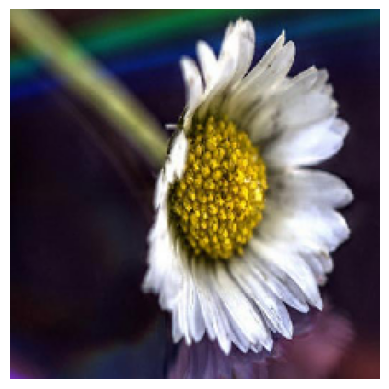

1/1 [==============================] - 0s 32ms/step
ResNet50 Prediction: [[8.4008253e-01 1.5991688e-01 1.2481054e-07 5.4294265e-08 4.3481270e-07]]
1/1 [==============================] - 0s 30ms/step
VGG16 Prediction: [[8.8154334e-01 1.1845579e-01 1.2544683e-07 6.7541737e-07 6.9796047e-10]]
1/1 [==============================] - 0s 40ms/step
InceptionV3 Prediction: [[9.99999762e-01 1.81199439e-07 2.46329818e-10 1.28653515e-08
  4.39760207e-12]]

Image: /content/test/daisy/33891398493_e0b6d7f683_n_jpg.rf.37a6c4970cf5e3ba04879f2ae6abe678.jpg


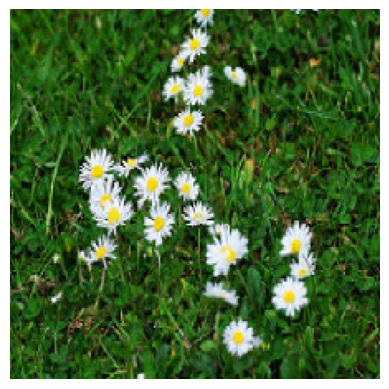

1/1 [==============================] - 0s 32ms/step
ResNet50 Prediction: [[9.0811914e-01 9.1880836e-02 6.6355138e-14 1.6776168e-12 5.9812338e-10]]
1/1 [==============================] - 0s 25ms/step
VGG16 Prediction: [[8.81068826e-01 1.18914589e-01 1.26014775e-05 4.01984607e-06
  9.38096045e-10]]
1/1 [==============================] - 0s 36ms/step
InceptionV3 Prediction: [[1.0000000e+00 3.0149911e-09 1.9853561e-12 8.5502988e-10 7.6908439e-13]]

Image: /content/test/daisy/33843240613_0b736f9896_n_jpg.rf.7a082f903d2cf0aaf4f42baf09519223.jpg


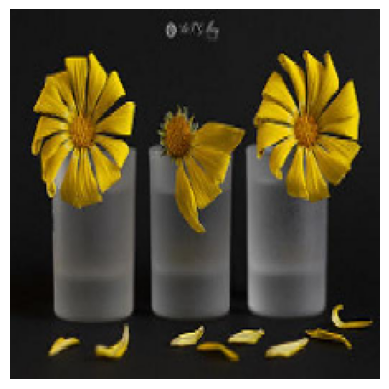

1/1 [==============================] - 0s 32ms/step
ResNet50 Prediction: [[4.6973220e-01 5.3025651e-01 5.8510746e-08 1.1253026e-05 2.8859855e-09]]
1/1 [==============================] - 0s 25ms/step
VGG16 Prediction: [[9.9965191e-01 2.9044747e-04 6.5181566e-06 4.4214328e-05 6.9121102e-06]]
1/1 [==============================] - 0s 35ms/step
InceptionV3 Prediction: [[9.9997044e-01 1.9126637e-05 3.3139088e-08 1.0405054e-05 9.4837569e-09]]

Image: /content/test/daisy/3463313493_9497aa47e5_n_jpg.rf.8116f374bc71c06b065c2ef82c0757b3.jpg


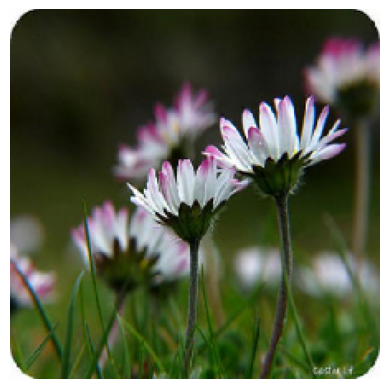

1/1 [==============================] - 0s 32ms/step
ResNet50 Prediction: [[9.3347973e-01 6.6507980e-02 9.4106549e-11 1.2336716e-05 1.4904673e-08]]
1/1 [==============================] - 0s 24ms/step
VGG16 Prediction: [[9.7103024e-01 2.8925778e-02 1.5712802e-05 2.8313294e-05 6.2380940e-09]]
1/1 [==============================] - 0s 48ms/step
InceptionV3 Prediction: [[9.9895775e-01 1.0395990e-03 1.2383045e-07 2.5130826e-06 4.2913850e-09]]

Image: /content/test/daisy/5905504340_1d60fa9611_n_jpg.rf.c12deb4c8d87dd57f34aa81eaefe809f.jpg


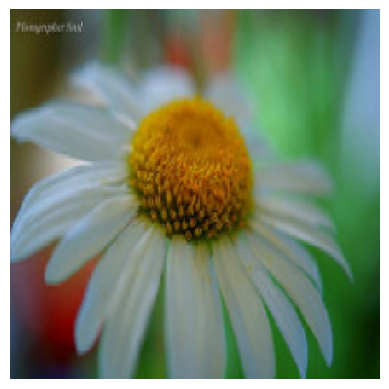

1/1 [==============================] - 0s 31ms/step
ResNet50 Prediction: [[3.24118108e-01 6.74708426e-01 1.15538905e-05 1.03873515e-03
  1.23182617e-04]]
1/1 [==============================] - 0s 25ms/step
VGG16 Prediction: [[9.8011601e-01 1.9883182e-02 5.0768222e-07 3.3855846e-07 3.1564249e-09]]
1/1 [==============================] - 0s 35ms/step
InceptionV3 Prediction: [[9.9999952e-01 4.6181614e-07 1.9068280e-10 1.7933557e-08 1.1565757e-11]]

Image: /content/test/daisy/476856232_7c35952f40_n_jpg.rf.28b0b70acae8079b2d47f23e5eefbd86.jpg


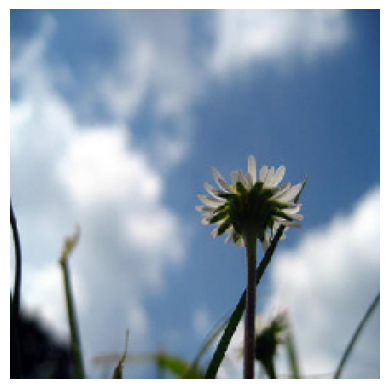

1/1 [==============================] - 0s 32ms/step
ResNet50 Prediction: [[2.1105871e-01 4.1214889e-01 2.1926167e-04 3.7643030e-01 1.4285375e-04]]
1/1 [==============================] - 0s 25ms/step
VGG16 Prediction: [[1.3387229e-01 8.6604875e-01 7.1477676e-05 4.0217406e-06 3.4692562e-06]]
1/1 [==============================] - 0s 35ms/step
InceptionV3 Prediction: [[8.0353938e-02 9.1959035e-01 5.2759908e-05 2.7906049e-06 1.2853037e-07]]

Image: /content/test/daisy/14564545365_1f1d267bf1_n_jpg.rf.b848a44633a90175f6df714901554324.jpg


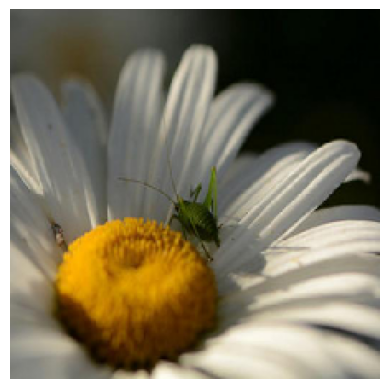

1/1 [==============================] - 0s 45ms/step
ResNet50 Prediction: [[4.6001840e-01 5.3997940e-01 1.7895543e-07 4.0768134e-07 1.6083719e-06]]
1/1 [==============================] - 0s 28ms/step
VGG16 Prediction: [[9.9553716e-01 4.4380496e-03 2.4524261e-05 3.1802497e-07 1.0281014e-11]]
1/1 [==============================] - 0s 52ms/step
InceptionV3 Prediction: [[9.9999988e-01 6.0956232e-08 3.9678084e-11 1.2344386e-09 1.4137345e-12]]

Image: /content/test/daisy/16025261368_911703a536_n_jpg.rf.ecd6ca15230613fb42fb7de502c0deca.jpg


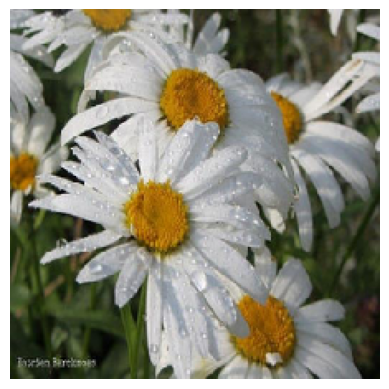

1/1 [==============================] - 0s 41ms/step
ResNet50 Prediction: [[7.3780030e-01 2.6219967e-01 7.2349279e-12 1.4678618e-08 1.0199699e-10]]
1/1 [==============================] - 0s 35ms/step
VGG16 Prediction: [[9.9999845e-01 1.5622859e-06 9.5362269e-09 1.3211027e-09 2.0797491e-14]]
1/1 [==============================] - 0s 57ms/step
InceptionV3 Prediction: [[1.0000000e+00 7.0189310e-10 8.3471066e-13 8.2041735e-11 1.1751644e-14]]

Image: /content/test/daisy/7416083788_fcb4c4f27e_n_jpg.rf.2d472cec430def057801f48e2b210c8c.jpg


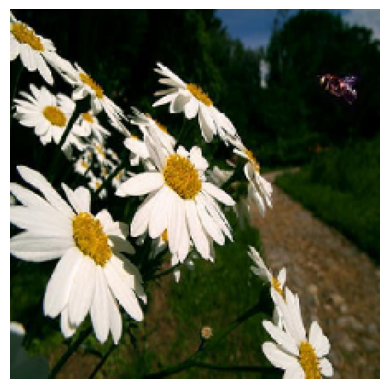

1/1 [==============================] - 0s 66ms/step
ResNet50 Prediction: [[9.94577646e-01 5.42232813e-03 6.59711982e-16 6.84397195e-17
  1.14408974e-20]]
1/1 [==============================] - 0s 52ms/step
VGG16 Prediction: [[9.9950707e-01 4.9159350e-04 1.2780865e-06 3.8490221e-08 4.4750398e-11]]
1/1 [==============================] - 0s 46ms/step
InceptionV3 Prediction: [[9.9999964e-01 3.9430512e-07 5.1133819e-10 7.5438003e-09 1.0133421e-11]]

Image: /content/test/daisy/4482623536_b9fb5ae41f_n_jpg.rf.813cac3ea9f4432e19bf380c747867eb.jpg


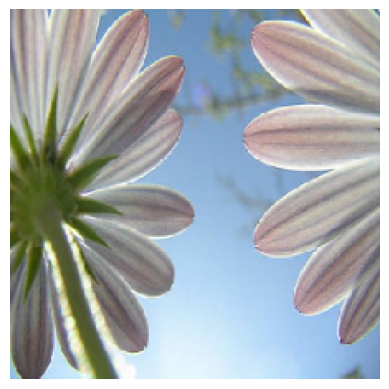

1/1 [==============================] - 0s 41ms/step
ResNet50 Prediction: [[3.0472893e-01 6.9526941e-01 7.0659304e-08 4.2140863e-07 1.2558725e-06]]
1/1 [==============================] - 0s 31ms/step
VGG16 Prediction: [[9.9994349e-01 2.3806442e-06 5.4158776e-05 6.2133312e-11 7.4928216e-11]]
1/1 [==============================] - 0s 39ms/step
InceptionV3 Prediction: [[9.9998915e-01 6.7255505e-06 1.5068467e-08 4.1998569e-06 6.9839740e-10]]

Image: /content/test/daisy/18684594849_7dd3634f5e_n_jpg.rf.a2b07018b0bd7da828eb929cbd0ce9dd.jpg


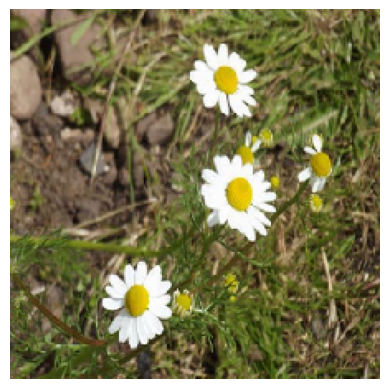

1/1 [==============================] - 0s 47ms/step
ResNet50 Prediction: [[9.4271523e-01 5.7284810e-02 8.7073821e-14 3.6121228e-11 1.8423398e-10]]
1/1 [==============================] - 0s 32ms/step
VGG16 Prediction: [[9.9477839e-01 5.2207657e-03 7.7412028e-07 1.8873108e-08 1.4030653e-12]]
1/1 [==============================] - 0s 50ms/step
InceptionV3 Prediction: [[1.0000000e+00 2.4656336e-11 1.0707874e-14 6.7401527e-12 1.9920013e-16]]

Image: /content/test/daisy/34562146951_cf3d2a627c_n_jpg.rf.abd65a51f37ada4fc322c6cad6613e02.jpg


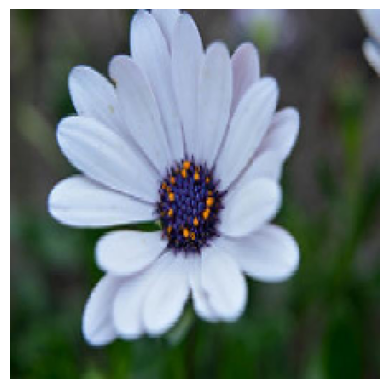

1/1 [==============================] - 0s 54ms/step
ResNet50 Prediction: [[8.7657970e-01 1.2341970e-01 7.7984517e-09 4.1076323e-08 5.9929192e-07]]
1/1 [==============================] - 0s 39ms/step
VGG16 Prediction: [[9.9999833e-01 1.5765012e-06 2.7766522e-08 1.4091485e-07 3.2685881e-09]]
1/1 [==============================] - 0s 37ms/step
InceptionV3 Prediction: [[9.99999762e-01 2.26044207e-07 3.55868279e-10 1.25477095e-08
  1.29727661e-11]]

Image: /content/test/daisy/1392131677_116ec04751_jpg.rf.da99f9bb579ee96dc1728545ca519d6f.jpg


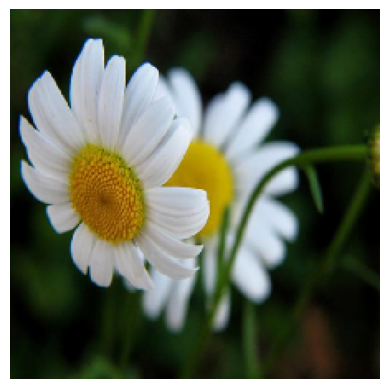

1/1 [==============================] - 0s 32ms/step
ResNet50 Prediction: [[8.8042921e-01 1.1957062e-01 9.7409689e-08 1.2859354e-07 3.0519359e-08]]
1/1 [==============================] - 0s 27ms/step
VGG16 Prediction: [[9.9992383e-01 7.4870906e-05 1.1382671e-06 1.4418941e-07 3.7910237e-11]]
1/1 [==============================] - 0s 56ms/step
InceptionV3 Prediction: [[9.9999940e-01 6.5272934e-07 7.2337797e-10 1.4023925e-08 7.5215025e-12]]

Image: /content/test/daisy/6480809573_76a0074b69_n_jpg.rf.c91f24e489b548f07ba35d9e1bb034eb.jpg


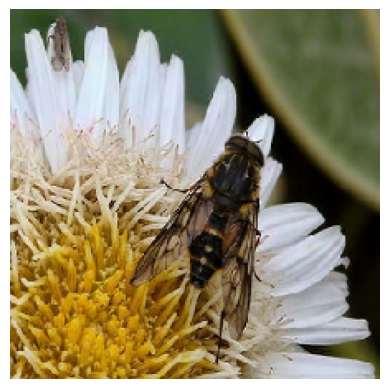

1/1 [==============================] - 0s 33ms/step
ResNet50 Prediction: [[9.1139966e-01 8.8595979e-02 1.2370285e-09 1.6021259e-09 4.3771047e-06]]
1/1 [==============================] - 0s 25ms/step
VGG16 Prediction: [[2.7313158e-01 7.2597426e-01 8.9291070e-04 1.2538530e-06 4.5356505e-10]]
1/1 [==============================] - 0s 36ms/step
InceptionV3 Prediction: [[9.9986482e-01 1.3380407e-04 2.7149694e-09 1.3429894e-06 7.4544731e-11]]

Image: /content/test/daisy/7066602021_2647457985_m_jpg.rf.29bb36e3cd303b49067673e6000954d1.jpg


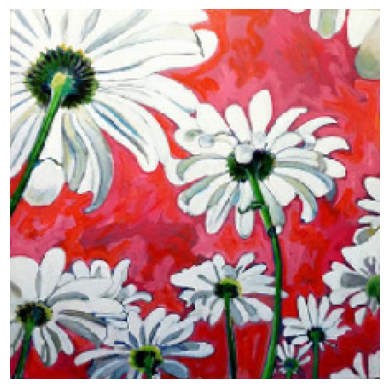

1/1 [==============================] - 0s 34ms/step
ResNet50 Prediction: [[9.9768376e-01 2.3162700e-03 3.7695231e-19 1.8461439e-14 3.7864194e-16]]
1/1 [==============================] - 0s 25ms/step
VGG16 Prediction: [[9.9999499e-01 4.8791821e-06 1.6439968e-07 6.5392642e-09 3.1579698e-12]]
1/1 [==============================] - 0s 60ms/step
InceptionV3 Prediction: [[9.9949491e-01 1.8253790e-04 2.5878260e-06 3.1995852e-04 3.4735802e-08]]

Image: /content/test/daisy/1354396826_2868631432_m_jpg.rf.409eee37613d16dbc71365cb5615327e.jpg


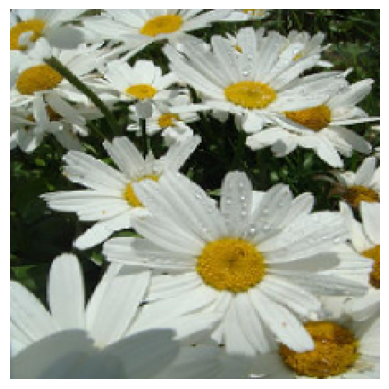

1/1 [==============================] - 0s 32ms/step
ResNet50 Prediction: [[9.9464560e-01 5.3544641e-03 2.0419274e-19 7.5136804e-16 1.1315960e-15]]
1/1 [==============================] - 0s 26ms/step
VGG16 Prediction: [[9.9999154e-01 8.3690093e-06 1.8565713e-08 5.2845429e-08 2.0001360e-12]]
1/1 [==============================] - 0s 38ms/step
InceptionV3 Prediction: [[1.0000000e+00 5.8502422e-08 1.3358714e-10 4.7186757e-09 3.6157828e-12]]

Image: /content/test/daisy/7538403124_f2fc48750a_jpg.rf.39fc5a380d9e0292651207460311fd5d.jpg


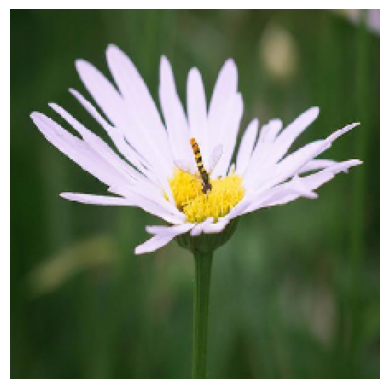

1/1 [==============================] - 0s 37ms/step
ResNet50 Prediction: [[9.8140198e-01 1.8598044e-02 4.8241468e-08 3.1020673e-09 2.5491724e-08]]
1/1 [==============================] - 0s 28ms/step
VGG16 Prediction: [[9.9413222e-01 4.9052252e-03 9.6242275e-04 6.1253850e-08 1.5290120e-09]]
1/1 [==============================] - 0s 42ms/step
InceptionV3 Prediction: [[9.9999976e-01 1.9061825e-07 7.0592071e-10 1.3971707e-08 1.3353380e-11]]

Image: /content/test/daisy/9345273630_af3550031d_jpg.rf.3a2b558ca9c965532e017fa059d0bd14.jpg


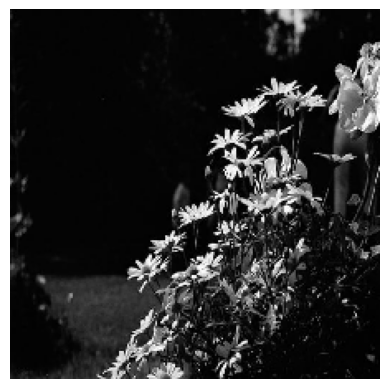

1/1 [==============================] - 0s 31ms/step
ResNet50 Prediction: [[9.6527147e-01 3.4728453e-02 2.4573315e-22 2.1721066e-14 7.4385077e-28]]
1/1 [==============================] - 0s 24ms/step
VGG16 Prediction: [[1.7258219e-01 8.2720286e-01 6.1408440e-07 2.1350173e-04 8.7021431e-07]]
1/1 [==============================] - 0s 42ms/step
InceptionV3 Prediction: [[3.6404955e-01 6.2915570e-01 3.1944339e-03 3.5283719e-03 7.1960450e-05]]

Image: /content/test/daisy/33843400403_db00aa16b8_n_jpg.rf.64efb71797dc8096ab5fe372a8c3ce71.jpg


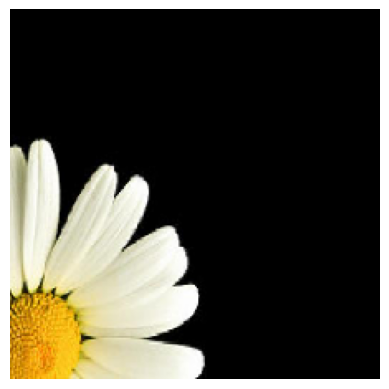

1/1 [==============================] - 0s 35ms/step
ResNet50 Prediction: [[9.7774613e-01 2.2235267e-02 1.1061892e-08 2.9333636e-09 1.8607261e-05]]
1/1 [==============================] - 0s 25ms/step
VGG16 Prediction: [[9.9944466e-01 5.2624149e-04 8.6306136e-06 2.0465452e-05 1.3968613e-08]]
1/1 [==============================] - 0s 36ms/step
InceptionV3 Prediction: [[9.9999988e-01 1.0807878e-07 2.0299946e-10 3.0564202e-08 7.9130808e-12]]

Image: /content/test/daisy/519880292_7a3a6c6b69_jpg.rf.4329ebaba670fde97cec43b151764ae3.jpg


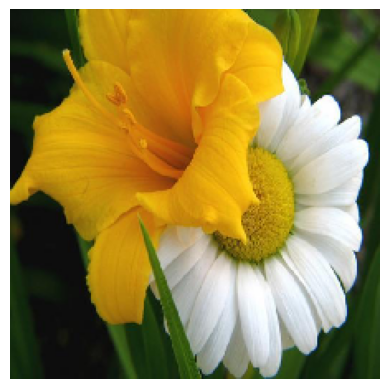

1/1 [==============================] - 0s 32ms/step
ResNet50 Prediction: [[8.7262636e-01 1.2720902e-01 2.8614931e-08 1.6194781e-04 2.5640061e-06]]
1/1 [==============================] - 0s 27ms/step
VGG16 Prediction: [[9.9984145e-01 1.1492749e-04 3.7724333e-06 1.5297019e-05 2.4595016e-05]]
1/1 [==============================] - 0s 35ms/step
InceptionV3 Prediction: [[9.9998891e-01 1.0660577e-05 2.2308935e-09 4.3493552e-07 1.3383815e-10]]

Image: /content/test/daisy/34695914906_961f92ffcd_n_jpg.rf.de50f4cd24e39e40099bb3339d6bb101.jpg


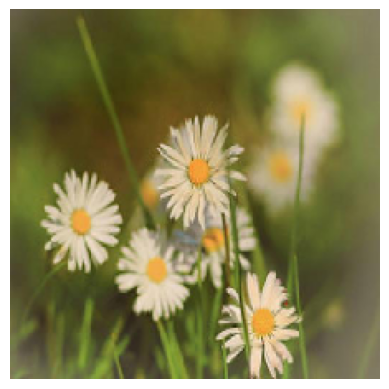

1/1 [==============================] - 0s 36ms/step
ResNet50 Prediction: [[5.0822532e-01 4.9173647e-01 1.3643130e-07 2.2262084e-05 1.5812398e-05]]
1/1 [==============================] - 0s 25ms/step
VGG16 Prediction: [[9.6441966e-01 3.5311386e-02 2.6588916e-04 2.9979401e-06 7.2274262e-09]]
1/1 [==============================] - 0s 37ms/step
InceptionV3 Prediction: [[9.9999726e-01 2.8000341e-06 1.5025467e-10 3.3750300e-09 4.1735339e-12]]

Image: /content/test/daisy/34542837641_10492bf600_n_jpg.rf.1fd640bbbafa6349eb6550a3df63e3a0.jpg


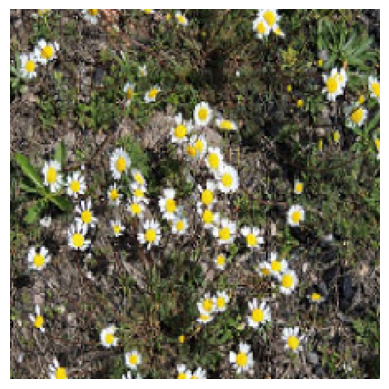

1/1 [==============================] - 0s 32ms/step
ResNet50 Prediction: [[4.1226462e-01 5.8773535e-01 9.5928517e-13 4.3041428e-11 1.5657467e-11]]
1/1 [==============================] - 0s 24ms/step
VGG16 Prediction: [[5.6833118e-01 4.3164670e-01 2.1592245e-05 5.0856181e-07 1.7924984e-10]]
1/1 [==============================] - 0s 35ms/step
InceptionV3 Prediction: [[9.9988842e-01 1.1073055e-04 4.3780577e-08 8.4342321e-07 1.4094330e-09]]

Image: /content/test/daisy/6089825811_80f253fbe1_jpg.rf.edcaebb528c2b993324dc3ead633f7b9.jpg


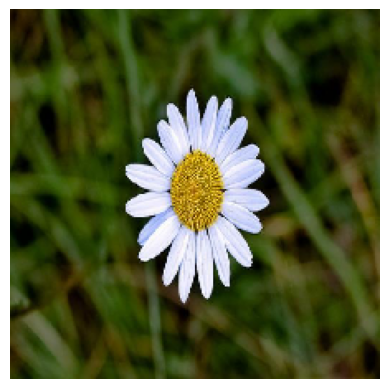

1/1 [==============================] - 0s 32ms/step
ResNet50 Prediction: [[9.9802363e-01 1.9755496e-03 1.0205324e-11 8.8131549e-07 2.4577866e-11]]
1/1 [==============================] - 0s 31ms/step
VGG16 Prediction: [[9.9679095e-01 3.1947386e-03 1.4212919e-05 5.9281802e-09 2.7275022e-13]]
1/1 [==============================] - 0s 41ms/step
InceptionV3 Prediction: [[1.0000000e+00 5.0927252e-08 2.2419254e-11 1.4601224e-09 4.3745950e-13]]

Image: /content/test/daisy/5896110423_e084b33401_n_jpg.rf.e39901a7d317219e85ec14794521d040.jpg


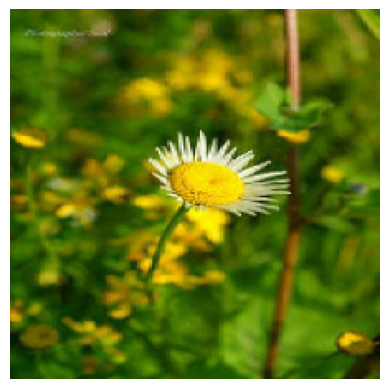

1/1 [==============================] - 0s 32ms/step
ResNet50 Prediction: [[5.3658825e-01 4.6338856e-01 8.1295568e-08 7.3860429e-07 2.2378843e-05]]
1/1 [==============================] - 0s 24ms/step
VGG16 Prediction: [[3.6700389e-01 6.3299203e-01 4.0364225e-06 2.0075964e-08 7.5025576e-12]]
1/1 [==============================] - 0s 40ms/step
InceptionV3 Prediction: [[9.9972528e-01 2.7471254e-04 7.3674338e-09 3.5986378e-08 4.9952913e-11]]

Image: /content/test/daisy/4858518329_7563eb0baa_m_jpg.rf.87b1251614bb568f499b6af22e3347ab.jpg


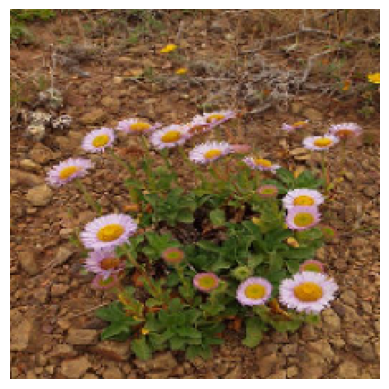

1/1 [==============================] - 0s 33ms/step
ResNet50 Prediction: [[2.6650482e-01 7.3349452e-01 4.4343391e-09 6.2617102e-07 6.3364456e-09]]
1/1 [==============================] - 0s 26ms/step
VGG16 Prediction: [[4.3869445e-01 5.6130189e-01 1.2964196e-06 2.3945095e-06 5.6274382e-12]]
1/1 [==============================] - 0s 47ms/step
InceptionV3 Prediction: [[9.9976975e-01 2.2938510e-04 1.6032172e-07 6.8367444e-07 2.1643288e-08]]

Image: /content/test/daisy/14333681205_a07c9f1752_m_jpg.rf.6ff96d9fe33f0bd19a18425f32d470b1.jpg


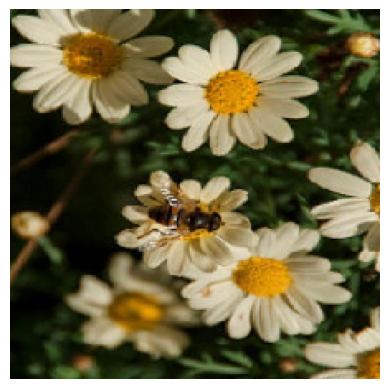

1/1 [==============================] - 0s 32ms/step
ResNet50 Prediction: [[9.7006547e-01 2.9934539e-02 2.2226173e-18 4.5940922e-14 2.1864860e-14]]
1/1 [==============================] - 0s 26ms/step
VGG16 Prediction: [[9.9970907e-01 2.9073484e-04 5.7284119e-08 5.4747694e-08 4.2274921e-12]]
1/1 [==============================] - 0s 40ms/step
InceptionV3 Prediction: [[1.0000000e+00 1.9900954e-08 2.2829058e-11 2.7325076e-09 3.3498925e-13]]

Image: /content/test/daisy/5765646947_82e95a9cc9_n_jpg.rf.81b496130743dfd52fce21f5e2dd9570.jpg


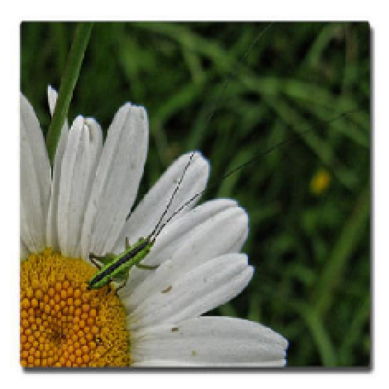

1/1 [==============================] - 0s 32ms/step
ResNet50 Prediction: [[2.3089620e-01 7.6909709e-01 8.7744883e-07 5.6641848e-06 1.9372052e-07]]
1/1 [==============================] - 0s 28ms/step
VGG16 Prediction: [[9.9717999e-01 1.6504088e-03 1.1690157e-03 5.4244634e-07 1.4355463e-09]]
1/1 [==============================] - 0s 53ms/step
InceptionV3 Prediction: [[9.9999785e-01 1.4616985e-06 1.1628552e-08 7.2445704e-07 7.3265810e-10]]

Image: /content/test/daisy/12193032636_b50ae7db35_n_jpg.rf.e6c4eeb71c56e793a0d85f6d979dbe20.jpg


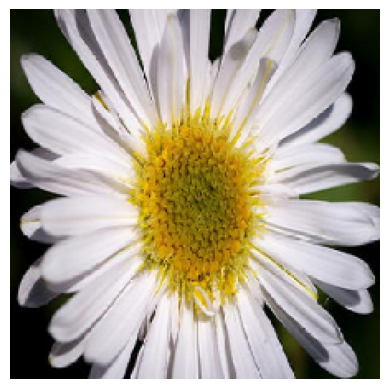

1/1 [==============================] - 0s 33ms/step
ResNet50 Prediction: [[6.8130153e-01 3.1869850e-01 7.1980033e-10 1.0223390e-08 3.5290075e-09]]
1/1 [==============================] - 0s 26ms/step
VGG16 Prediction: [[9.9998391e-01 5.8298642e-06 1.0201575e-05 1.1840517e-12 7.9959622e-15]]
1/1 [==============================] - 0s 37ms/step
InceptionV3 Prediction: [[9.9999559e-01 4.2570364e-06 6.8781194e-09 6.2802940e-08 5.1803086e-11]]

Image: /content/test/daisy/3504430338_77d6a7fab4_n_jpg.rf.4a993cefe2d15b8f964ab28bf7606c85.jpg


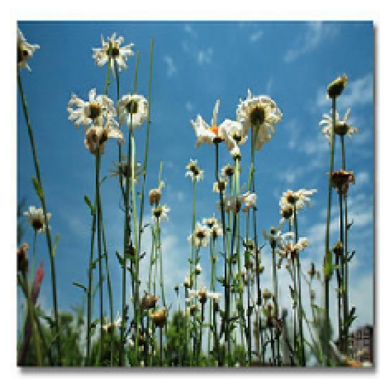

1/1 [==============================] - 0s 33ms/step
ResNet50 Prediction: [[3.3930168e-01 6.6068369e-01 2.9798490e-09 1.4542043e-05 5.7416294e-09]]
1/1 [==============================] - 0s 29ms/step
VGG16 Prediction: [[3.3540823e-02 9.6578735e-01 6.5539073e-04 1.4494278e-05 1.9988097e-06]]
1/1 [==============================] - 0s 41ms/step
InceptionV3 Prediction: [[5.0216138e-01 4.9782556e-01 2.1508861e-06 9.8389937e-06 1.0532053e-06]]

Image: /content/test/daisy/33879354664_615c72773d_n_jpg.rf.60764f87614dfb0231f4cc2de3767e6d.jpg


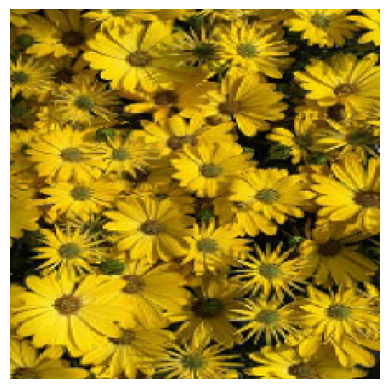

1/1 [==============================] - 0s 34ms/step
ResNet50 Prediction: [[5.6578773e-01 4.3421224e-01 6.1771270e-13 3.8800241e-10 4.8048322e-11]]
1/1 [==============================] - 0s 26ms/step
VGG16 Prediction: [[4.5757926e-01 5.4228020e-01 3.6860612e-05 1.0368105e-04 1.3275109e-09]]
1/1 [==============================] - 0s 37ms/step
InceptionV3 Prediction: [[9.9961108e-01 2.8986202e-04 1.1396801e-06 9.7736898e-05 2.1963668e-07]]

Image: /content/test/daisy/22873310415_3a5674ec10_m_jpg.rf.481813ecfd025260ce55f8a383eef955.jpg


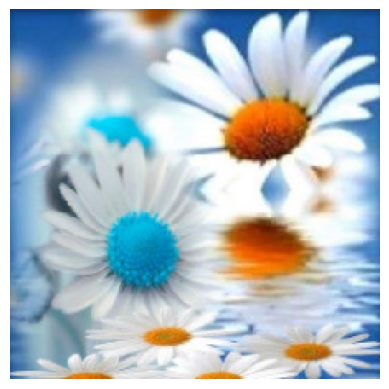

1/1 [==============================] - 0s 39ms/step
ResNet50 Prediction: [[8.7430012e-01 1.2569965e-01 2.0112474e-10 2.7908296e-09 1.8761116e-07]]
1/1 [==============================] - 0s 29ms/step
VGG16 Prediction: [[9.9988866e-01 1.1110768e-04 2.4067043e-07 9.1809182e-09 7.1971877e-13]]
1/1 [==============================] - 0s 66ms/step
InceptionV3 Prediction: [[9.9999809e-01 1.8549288e-06 8.3591800e-10 3.8498261e-08 2.4279677e-11]]

Image: /content/test/daisy/6207492986_0ff91f3296_jpg.rf.03fc13bc6c049b950ab318b108e0283d.jpg


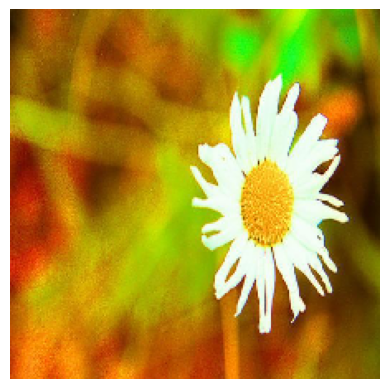

1/1 [==============================] - 0s 52ms/step
ResNet50 Prediction: [[9.2199099e-01 7.7999361e-02 4.8391495e-08 9.6086760e-06 2.1748528e-08]]
1/1 [==============================] - 0s 38ms/step
VGG16 Prediction: [[9.9897623e-01 1.0206249e-03 3.0031670e-06 2.0595090e-07 2.1961086e-09]]
1/1 [==============================] - 0s 35ms/step
InceptionV3 Prediction: [[9.9995255e-01 4.7375161e-05 1.3461271e-08 1.4007088e-07 5.8679500e-10]]

Image: /content/test/daisy/18442919723_d1251d3e14_n_jpg.rf.63fc73ffb788b8bca6a8adb298e082a0.jpg


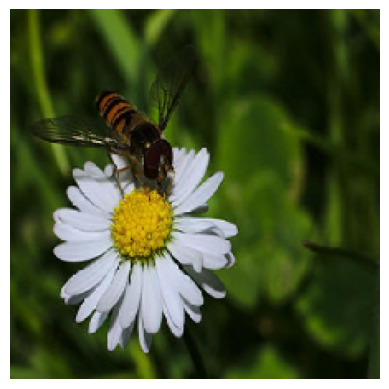

1/1 [==============================] - 0s 38ms/step
ResNet50 Prediction: [[7.9475689e-01 2.0524317e-01 1.0181784e-11 1.3060045e-10 1.6350412e-09]]
1/1 [==============================] - 0s 74ms/step
VGG16 Prediction: [[9.9981588e-01 1.8319757e-04 1.0035288e-06 1.6776742e-09 2.0399524e-10]]
1/1 [==============================] - 0s 61ms/step
InceptionV3 Prediction: [[9.9999213e-01 7.8111934e-06 1.5513744e-09 4.3312745e-08 2.7194068e-11]]

Image: /content/test/daisy/14591326135_930703dbed_m_jpg.rf.10cc8279dba4fb0032a954596fbe99a9.jpg


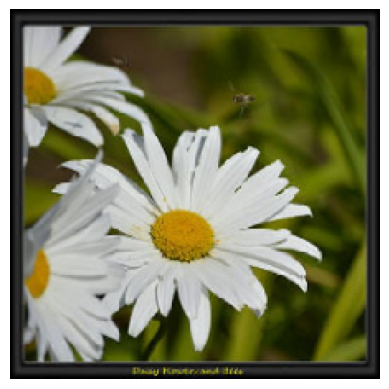

1/1 [==============================] - 0s 46ms/step
ResNet50 Prediction: [[9.7895765e-01 2.1042338e-02 5.6833392e-12 3.6983945e-09 3.3479111e-10]]
1/1 [==============================] - 0s 32ms/step
VGG16 Prediction: [[9.9982053e-01 1.7259375e-04 6.9454918e-06 2.5412129e-08 3.2990275e-12]]
1/1 [==============================] - 0s 62ms/step
InceptionV3 Prediction: [[1.0000000e+00 5.4007021e-08 2.7802562e-11 1.1074242e-09 3.3410609e-13]]

Image: /content/test/daisy/476857510_d2b30175de_n_jpg.rf.40ff83ae9c6f996b11149eaf1eafcc2e.jpg


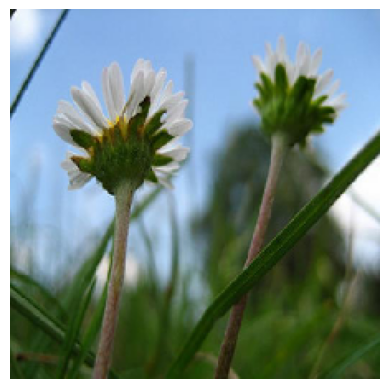

1/1 [==============================] - 0s 40ms/step
ResNet50 Prediction: [[6.9236070e-01 3.0735606e-01 2.4450778e-06 2.7562745e-04 5.1680518e-06]]
1/1 [==============================] - 0s 33ms/step
VGG16 Prediction: [[9.0460104e-01 9.5264032e-02 1.3488879e-04 4.6760601e-08 3.7280515e-08]]
1/1 [==============================] - 0s 61ms/step
InceptionV3 Prediction: [[9.9996567e-01 3.4311197e-05 1.7040793e-09 5.4058447e-08 8.6893492e-11]]

Image: /content/test/daisy/6136947177_47ff445eb4_n_jpg.rf.c11557c9c68f27732233f8837c47ff04.jpg


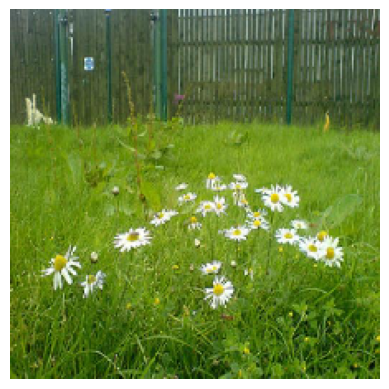

1/1 [==============================] - 0s 52ms/step
ResNet50 Prediction: [[5.3392601e-01 4.6607381e-01 1.2473383e-09 8.6495994e-08 3.4096338e-08]]
1/1 [==============================] - 0s 59ms/step
VGG16 Prediction: [[4.5259672e-01 5.4736763e-01 1.2039279e-06 3.4397945e-05 3.0154395e-09]]
1/1 [==============================] - 0s 57ms/step
InceptionV3 Prediction: [[9.9993324e-01 6.6359265e-05 2.7629053e-08 3.5888996e-07 9.1255081e-10]]

Image: /content/test/daisy/5435513198_90ce39f1aa_n_jpg.rf.2dd15803ebf6cc6e5500274f0c21bb14.jpg


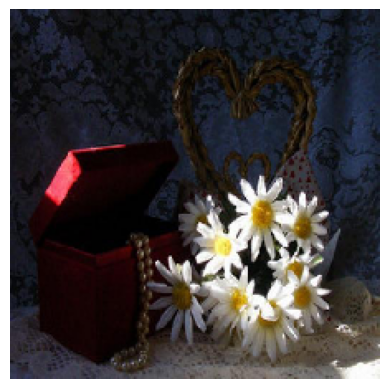

1/1 [==============================] - 0s 32ms/step
ResNet50 Prediction: [[8.72853220e-01 1.27146751e-01 1.72752958e-11 5.33153344e-09
  1.06056185e-10]]
1/1 [==============================] - 0s 25ms/step
VGG16 Prediction: [[9.6054876e-01 3.9424282e-02 1.3271262e-05 1.3481667e-05 8.0282597e-08]]
1/1 [==============================] - 0s 39ms/step
InceptionV3 Prediction: [[9.9999952e-01 4.2580544e-07 3.5962157e-11 4.5316502e-09 2.0243778e-12]]

Image: /content/test/daisy/14399435971_ea5868c792_jpg.rf.89b733453e10d461d440acc99b7ef6d1.jpg


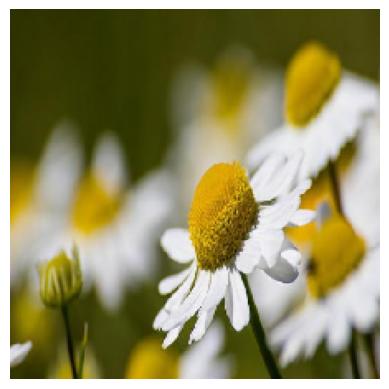

1/1 [==============================] - 0s 43ms/step
ResNet50 Prediction: [[8.9432478e-01 1.0567398e-01 7.8337080e-11 1.3012507e-06 7.5319695e-10]]
1/1 [==============================] - 0s 27ms/step
VGG16 Prediction: [[9.9696392e-01 2.9782853e-03 1.0456713e-06 5.6293229e-05 4.7719431e-07]]
1/1 [==============================] - 0s 36ms/step
InceptionV3 Prediction: [[9.9999809e-01 1.5219599e-06 3.2006142e-09 3.8168059e-07 2.1628850e-10]]

Image: /content/test/daisy/14613443462_d4ed356201_jpg.rf.76462b3f0cb5ca5a0b4b7c9894feb91c.jpg


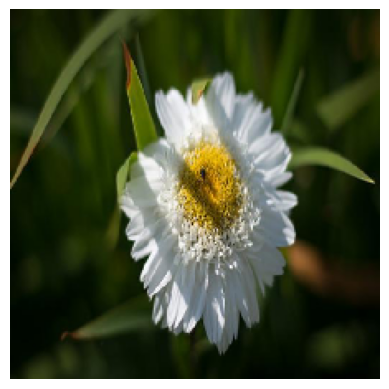

1/1 [==============================] - 0s 34ms/step
ResNet50 Prediction: [[5.7000935e-01 4.2997628e-01 5.4618777e-08 1.9469001e-06 1.2362471e-05]]
1/1 [==============================] - 0s 25ms/step
VGG16 Prediction: [[3.4681901e-01 6.5317142e-01 6.5557865e-06 2.9794185e-06 4.7790333e-08]]
1/1 [==============================] - 0s 37ms/step
InceptionV3 Prediction: [[9.9998856e-01 1.1211163e-05 6.2355343e-09 1.9290479e-07 3.2645775e-11]]

Image: /content/test/daisy/4563059851_45a9d21a75_jpg.rf.322b95999c283d3b3aa41ae741838ce5.jpg


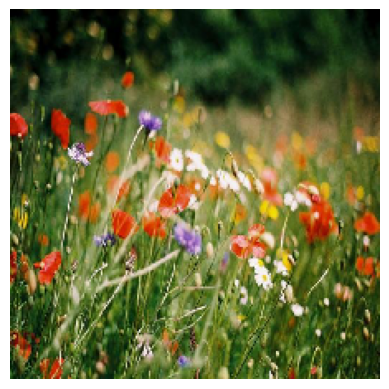

1/1 [==============================] - 0s 32ms/step
ResNet50 Prediction: [[3.3473435e-01 6.6526562e-01 6.8089430e-11 1.7659681e-09 1.3754115e-08]]
1/1 [==============================] - 0s 25ms/step
VGG16 Prediction: [[3.3541468e-01 6.6456264e-01 2.2270800e-05 3.8127945e-07 9.6324101e-11]]
1/1 [==============================] - 0s 35ms/step
InceptionV3 Prediction: [[9.4338793e-01 5.5318259e-02 7.7311700e-04 4.8224654e-04 3.8424860e-05]]

Image: /content/test/daisy/8322526877_95d1c0f8bc_n_jpg.rf.8f53aedefadc0395888c297925266102.jpg


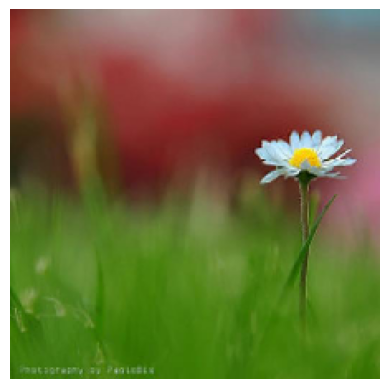

1/1 [==============================] - 0s 32ms/step
ResNet50 Prediction: [[6.8790966e-01 3.1197456e-01 2.4440678e-07 1.0285162e-04 1.2734736e-05]]
1/1 [==============================] - 0s 25ms/step
VGG16 Prediction: [[8.8605779e-01 1.1333033e-01 3.5481891e-05 5.7583681e-04 5.7404435e-07]]
1/1 [==============================] - 0s 39ms/step
InceptionV3 Prediction: [[9.9993181e-01 6.7749032e-05 3.5936395e-08 4.2286138e-07 1.2693078e-09]]

Image: /content/test/daisy/4117918318_3c8935289b_m_jpg.rf.c9dc5cde0a68b9354cf1712f62168b58.jpg


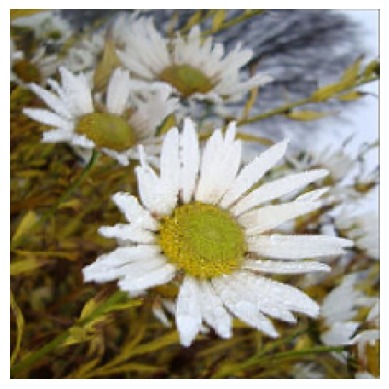

1/1 [==============================] - 0s 32ms/step
ResNet50 Prediction: [[8.4197927e-01 1.5802075e-01 7.4034420e-14 1.2933178e-11 2.3944301e-11]]
1/1 [==============================] - 0s 25ms/step
VGG16 Prediction: [[9.9815518e-01 1.8446948e-03 7.0269742e-08 3.0386097e-08 3.2762633e-13]]
1/1 [==============================] - 0s 45ms/step
InceptionV3 Prediction: [[1.0000000e+00 3.7666606e-08 2.2668215e-11 6.0390748e-10 4.4492432e-13]]

Image: /content/test/daisy/4790631791_21e9648097_n_jpg.rf.1832d669b0ba791616c97a52df3521df.jpg


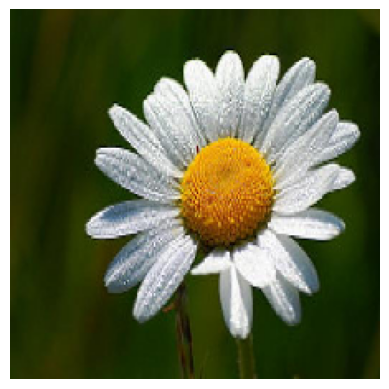

1/1 [==============================] - 0s 33ms/step
ResNet50 Prediction: [[9.8159224e-01 1.8407628e-02 1.1225546e-14 6.0947301e-08 7.4626123e-14]]
1/1 [==============================] - 0s 25ms/step
VGG16 Prediction: [[9.9999821e-01 1.6789896e-06 9.4971128e-08 8.4392378e-09 1.1693022e-10]]
1/1 [==============================] - 0s 37ms/step
InceptionV3 Prediction: [[9.9999833e-01 1.2193030e-06 4.7949236e-09 5.0773565e-07 4.2659437e-10]]

Image: /content/test/daisy/34571214621_f655295459_n_jpg.rf.54272370193af45f39956b40fb692970.jpg


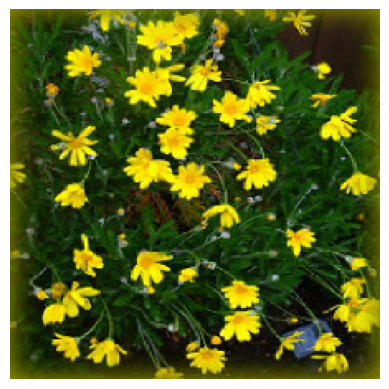

1/1 [==============================] - 0s 36ms/step
ResNet50 Prediction: [[8.7069523e-01 1.2930480e-01 2.2031689e-15 1.8436726e-12 6.3158555e-13]]
1/1 [==============================] - 0s 25ms/step
VGG16 Prediction: [[9.0676606e-01 9.3230300e-02 1.8144539e-07 3.4578541e-06 7.9602980e-10]]
1/1 [==============================] - 0s 43ms/step
InceptionV3 Prediction: [[9.9998081e-01 1.8913704e-05 1.8836165e-08 2.0923764e-07 3.0296443e-09]]

Image: /content/test/daisy/488202750_c420cbce61_jpg.rf.ebf7d924209a96639fffea69bd279a8c.jpg


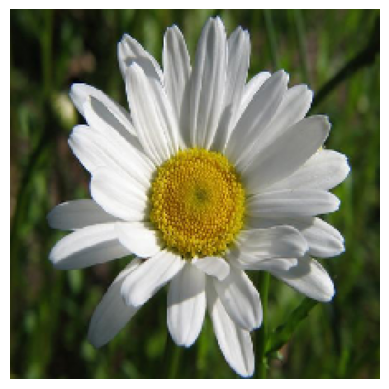

1/1 [==============================] - 0s 32ms/step
ResNet50 Prediction: [[9.6372020e-01 3.6279831e-02 2.3488342e-14 1.5083470e-09 1.0402845e-11]]
1/1 [==============================] - 0s 25ms/step
VGG16 Prediction: [[9.999999e-01 7.227999e-08 5.109557e-08 7.040460e-11 2.005423e-13]]
1/1 [==============================] - 0s 37ms/step
InceptionV3 Prediction: [[9.9999917e-01 7.3336753e-07 3.2239551e-09 8.1575237e-08 9.3114107e-11]]

Image: /content/test/dandelion/808239968_318722e4db_jpg.rf.8b3f341a8b6ab03f5f38d0f9d40acc75.jpg


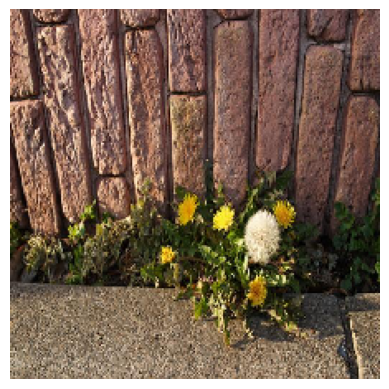

1/1 [==============================] - 0s 35ms/step
ResNet50 Prediction: [[1.3391833e-01 8.6608106e-01 2.7014460e-07 1.0829532e-08 2.9015663e-07]]
1/1 [==============================] - 0s 28ms/step
VGG16 Prediction: [[8.7474769e-01 1.2334537e-01 1.8835968e-03 2.3308312e-05 1.6490208e-10]]
1/1 [==============================] - 0s 43ms/step
InceptionV3 Prediction: [[8.6683236e-02 9.1321224e-01 9.4848430e-05 8.7514118e-06 8.7597152e-07]]

Image: /content/test/dandelion/34552250422_320900fd8e_n_jpg.rf.a9a6f2855e8c0dc156e4b0877fd0e8d4.jpg


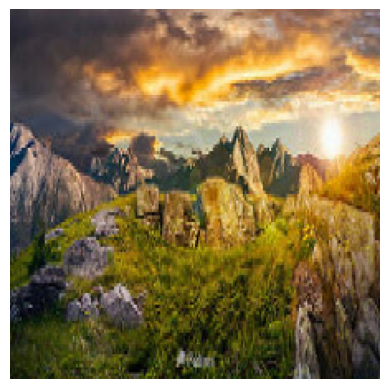

1/1 [==============================] - 0s 33ms/step
ResNet50 Prediction: [[1.9501771e-01 8.0495673e-01 2.0102270e-06 2.0168278e-05 3.3376712e-06]]
1/1 [==============================] - 0s 25ms/step
VGG16 Prediction: [[3.3851552e-01 6.6147065e-01 1.2356753e-06 1.2651771e-05 1.6544152e-10]]
1/1 [==============================] - 0s 36ms/step
InceptionV3 Prediction: [[9.7489500e-01 2.1594323e-02 9.9005748e-04 2.4728775e-03 4.7821064e-05]]

Image: /content/test/dandelion/461632542_0387557eff_jpg.rf.f66aef4fc0a966a83d804e9b819a8db3.jpg


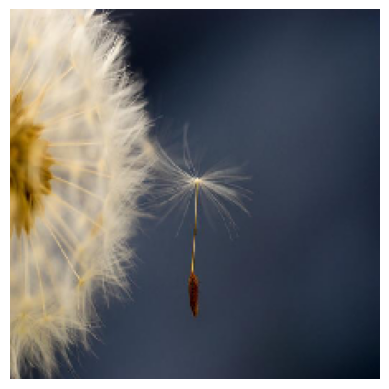

1/1 [==============================] - 0s 36ms/step
ResNet50 Prediction: [[2.6164624e-01 7.3792303e-01 3.5723289e-05 6.8615045e-05 3.2632236e-04]]
1/1 [==============================] - 0s 25ms/step
VGG16 Prediction: [[6.9239025e-04 9.9929190e-01 2.9058051e-06 1.2646835e-05 1.0476088e-07]]
1/1 [==============================] - 0s 38ms/step
InceptionV3 Prediction: [[3.3480535e-06 9.9999666e-01 9.1328305e-09 3.2948906e-09 1.1322856e-10]]

Image: /content/test/dandelion/3554435478_1a7ab743e9_n_jpg.rf.07d5667ff8bfd641e5004f6b2270d4b6.jpg


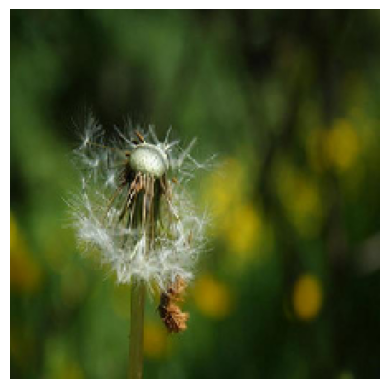

1/1 [==============================] - 0s 33ms/step
ResNet50 Prediction: [[2.577780e-01 7.420268e-01 8.136495e-06 9.231185e-05 9.473594e-05]]
1/1 [==============================] - 0s 24ms/step
VGG16 Prediction: [[1.4988597e-02 9.8500407e-01 4.2703823e-06 2.6732805e-06 3.4568978e-07]]
1/1 [==============================] - 0s 42ms/step
InceptionV3 Prediction: [[4.3313499e-03 9.9566770e-01 8.6249480e-07 4.6497206e-08 1.6331358e-09]]

Image: /content/test/dandelion/1297972485_33266a18d9_jpg.rf.27db91a578818f7158d6d5d98dbfdc8a.jpg


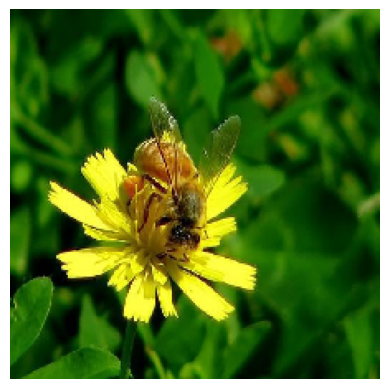

1/1 [==============================] - 0s 32ms/step
ResNet50 Prediction: [[5.3588599e-01 4.6411359e-01 3.6236831e-09 1.8193016e-07 1.9272217e-07]]
1/1 [==============================] - 0s 27ms/step
VGG16 Prediction: [[3.0785266e-01 6.9211507e-01 3.2233918e-05 1.4769132e-08 2.3359847e-11]]
1/1 [==============================] - 0s 39ms/step
InceptionV3 Prediction: [[8.88920903e-01 1.11071035e-01 3.58074004e-07 7.60655848e-06
  7.97867088e-08]]

Image: /content/test/dandelion/8613502159_d9ea67ba63_jpg.rf.cf240be43aa3907c0e6d4b705cb89432.jpg


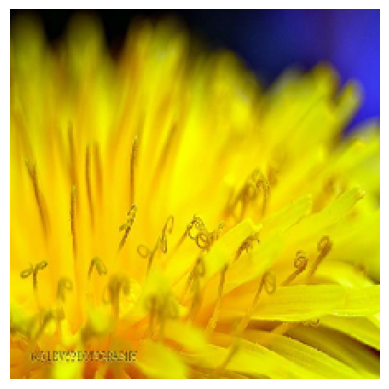

1/1 [==============================] - 0s 35ms/step
ResNet50 Prediction: [[2.9144493e-01 7.0767850e-01 4.4705692e-05 3.7313876e-05 7.9460797e-04]]
1/1 [==============================] - 0s 25ms/step
VGG16 Prediction: [[2.1296147e-02 9.7865218e-01 5.1548766e-05 1.0620984e-07 5.7576270e-11]]
1/1 [==============================] - 0s 35ms/step
InceptionV3 Prediction: [[1.4951502e-03 9.9845886e-01 4.2619511e-05 3.0380595e-06 2.3807044e-07]]

Image: /content/test/dandelion/17220096449_0e535989f0_n_jpg.rf.8db24b20eb779259f9480a46592ab911.jpg


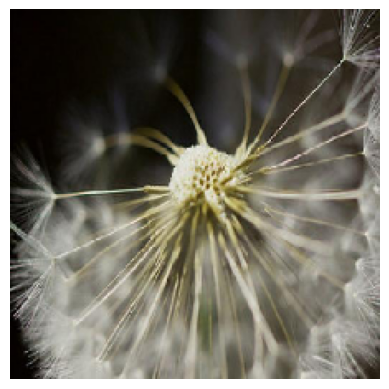

1/1 [==============================] - 0s 31ms/step
ResNet50 Prediction: [[4.3160269e-01 5.6829989e-01 2.7855842e-07 3.0024681e-05 6.7125766e-05]]
1/1 [==============================] - 0s 29ms/step
VGG16 Prediction: [[7.2223844e-04 9.9927503e-01 2.7384062e-06 4.7954851e-10 2.7287467e-12]]
1/1 [==============================] - 0s 41ms/step
InceptionV3 Prediction: [[5.4709904e-05 9.9994397e-01 4.3390386e-07 8.3938244e-07 6.0354006e-09]]

Image: /content/test/dandelion/8757650550_113d7af3bd_jpg.rf.15f92a268cac709e3670303db4a842a2.jpg


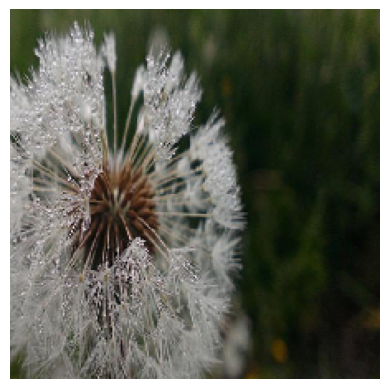

In [ ]:
for image_path in test_image_paths:
    print("Image:", image_path)

    img = image.load_img(image_path, target_size=(224, 224))
    plt.imshow(img)
    plt.axis('off')
    plt.show()

    print("ResNet50 Prediction:", predict_image(resnet_model_final, image_path))
    print("VGG16 Prediction:", predict_image(vgg_model_final, image_path))
    print("InceptionV3 Prediction:", predict_image(inception_model_final, image_path))
    print()
